#### **Authors:**
- Izquierdo Alvarez, Mario.
- Romero Romero, Martín.
# **Deep Learning - GANs Assignment**
## WGAN-GP - CelebA Faces

<div style="background-color: #ffffcc; padding: 10px;">

### **Introduction**
In this notebook, we explore the creation, training, and evaluation of various WGAN-GP models. Additionally, we provide commentary on the results obtained and an exploration of the latent space of the GANs, generating new images and interpolations between vectors in the latent space.

The code has been adapted from the excellent [WGAN-GP tutorial](https://keras.io/examples/generative/wgan_gp/) created by Aakash Kumar Nain, available on the Keras website.

</div>

In [1]:
import os
path = os.path.join('..')
os.sys.path.append(path)

In [2]:
%load_ext autoreload
%autoreload 2
import numpy as np

import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, utils, metrics, optimizers

from utils import display, sample_batch
import fid as fid

In [3]:
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from keras.datasets.mnist import load_data
from skimage.transform import resize
from keras.datasets import cifar10
from numpy.random import shuffle
from rich import print


## 0. Parameters <a name="parameters"></a>

In [4]:
IMAGE_SIZE = 64
CHANNELS = 3

BATCH_SIZE = 64
NUM_FEATURES = 128
Z_DIM = 128


EPOCHS = 40
STEPS_PER_EPOCH= 500


LEARNING_RATE = 0.0001
CRITIC_STEPS = 5

ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999

GP_WEIGHT = 10.0
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.9

## 1. Prepare the data <a name="prepare"></a>

In [5]:
# Load the data
train_data = utils.image_dataset_from_directory(
    "../archive/img_align_celeba/",
    labels=None,
    color_mode="rgb",
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    interpolation="bilinear",
)
# Repeat the dataset
train_data = train_data.repeat()

Found 202599 files.


In [6]:
# Preprocess the data
def preprocess(img):
    """
    Normalize and reshape the images
    """
    img = (tf.cast(img, "float32") - 127.5) / 127.5
    return img


train = train_data.map(lambda x: preprocess(x))

In [7]:
# Show some faces from the training set
train_sample = sample_batch(train)

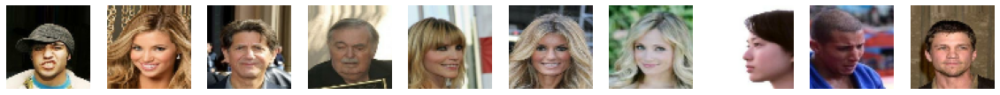

In [8]:
display(train_sample, cmap=None)

## 2. Build the Baseline WGAN-GP <a name="build"></a>

In [9]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d (Conv2D)                 │ (None, 32, 32, 64)        │      3,136 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_1 (Conv2D)               │ (None, 16, 16, 128)       │    131,200 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout (Dropout)               │ (None, 16, 16, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_2 (Conv2D)               │ (None, 8, 8, 256)         │    524,544 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 256)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_1 (Dropout)             │ (None, 8, 8, 256)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_3 (Conv2D)               │ (None, 4, 4, 512)         │  2,097,664 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout_2 (Dropout)             │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_4 (Conv2D)               │ (None, 1, 1, 1)           │      8,193 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ flatten (Flatten)               │ (None, 1)                 │          0 │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 2,764,737 (10.55 MB)

 Trainable params: 2,764,737 (10.55 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(512, kernel_size=4, strides=1, padding="valid", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh")(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ reshape (Reshape)               │ (None, 1, 1, 128)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose                │ (None, 4, 4, 512)         │  1,048,576 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization             │ (None, 4, 4, 512)         │      2,048 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_1              │ (None, 8, 8, 256)         │  2,097,152 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_1           │ (None, 8, 8, 256)         │      1,024 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 8, 8, 256)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_2              │ (None, 16, 16, 128)       │    524,288 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_2           │ (None, 16, 16, 128)       │        512 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 16, 16, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_3              │ (None, 32, 32, 64)        │    131,072 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_3           │ (None, 32, 32, 64)        │        256 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 32, 32, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_4              │ (None, 64, 64, 3)         │      3,075 │
│ (Conv2DTranspose)               │                           │            │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 3,808,003 (14.53 MB)

 Trainable params: 3,806,083 (14.52 MB)

 Non-trainable params: 1,920 (7.50 KB)

In [9]:
class WGANGP(models.Model):
    def __init__(self, critic, generator, latent_dim, critic_steps, gp_weight):
        super(WGANGP, self).__init__()
        self.critic = critic
        self.generator = generator
        self.latent_dim = latent_dim
        self.critic_steps = critic_steps
        self.gp_weight = gp_weight

        self.epoch = 0

    def compile(self, c_optimizer, g_optimizer):
        super(WGANGP, self).compile()
        self.c_optimizer = c_optimizer
        self.g_optimizer = g_optimizer
        self.c_wass_loss_metric = metrics.Mean(name="c_wass_loss")
        self.c_gp_metric = metrics.Mean(name="c_gp")
        self.c_loss_metric = metrics.Mean(name="c_loss")
        self.g_loss_metric = metrics.Mean(name="g_loss")

        # Additional metrics
        self.c_acc_metric = metrics.Mean(name="c_acc")
        self.g_acc_metric = metrics.Mean(name="g_acc")


    @property
    def metrics(self):
        return [self.c_loss_metric, self.c_wass_loss_metric, self.c_gp_metric, self.g_loss_metric, self.c_acc_metric, self.g_acc_metric]

    def gradient_penalty(self, batch_size, real_images, fake_images):
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            pred = self.critic(interpolated, training=True)

        grads = gp_tape.gradient(pred, [interpolated])[0]
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        

        for i in range(self.critic_steps):
            random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

            with tf.GradientTape() as tape:
                fake_images = self.generator(random_latent_vectors, training=True)
                fake_predictions = self.critic(fake_images, training=True)
                real_predictions = self.critic(real_images, training=True)

                c_wass_loss = tf.reduce_mean(fake_predictions) - tf.reduce_mean(real_predictions)
                c_gp = self.gradient_penalty(batch_size, real_images, fake_images)
                c_loss = c_wass_loss + c_gp * self.gp_weight

            c_gradient = tape.gradient(c_loss, self.critic.trainable_variables)
            self.c_optimizer.apply_gradients(zip(c_gradient, self.critic.trainable_variables))

        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_latent_vectors, training=True)
            fake_predictions = self.critic(fake_images, training=True)
            g_loss = -tf.reduce_mean(fake_predictions)

        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gen_gradient, self.generator.trainable_variables))

    
      # Calculate Critic and Generator Accuracy
        c_acc = tf.reduce_mean(tf.cast(tf.math.greater(real_predictions, 0), tf.float32)) * 100
        g_acc = tf.reduce_mean(tf.cast(tf.math.less(fake_predictions, 0), tf.float32)) * 100

        self.c_loss_metric.update_state(c_loss)
        self.c_wass_loss_metric.update_state(c_wass_loss)
        self.c_gp_metric.update_state(c_gp)
        self.g_loss_metric.update_state(g_loss)
        # Additional metrics
        self.c_acc_metric.update_state(c_acc)
        self.g_acc_metric.update_state(g_acc)

        metric_logs = {**{m.name: m.result() for m in self.metrics}, 'c_acc': c_acc, 'g_acc': g_acc}
        
        return metric_logs

In [12]:
# Create a GAN
wgangp = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

In [13]:
if LOAD_MODEL:
    wgangp.load_weights("./checkpoint/checkpoint.weights.h5")
    print('Weights loaded')

## 3. Train the GAN <a name="train"></a>

In [14]:
# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

In [10]:
class FIDCallback(callbacks.Callback):
    def __init__(self, real_images, latent_dim, num_img=100):
        self.real_images = real_images
        self.latent_dim = latent_dim
        self.num_img = num_img
        self.inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        
        # Normalize generated images to [0, 255] range
        generated_images = generated_images * 127.5 + 127.5
        generated_images = tf.clip_by_value(generated_images, 0, 255)

         # Select a random subset of real images
        real_images_subset = self._select_random_real_images()

        # Convert images to numpy arrays
        real_images_np = real_images_subset.numpy()
        generated_images_np = generated_images.numpy()

        # Resize images
        real_images_resized = fid.scale_images(real_images_np, (299, 299, 3))
        generated_images_resized = fid.scale_images(generated_images_np, (299, 299, 3))

        # Preprocess images
        real_images_resized = preprocess_input(real_images_resized)
        generated_images_resized = preprocess_input(generated_images_resized)

        # Calculate FID
        fid_score = fid.calculate_fid(self.inception_model, real_images_resized, generated_images_resized)
        
        # Log FID
        print(f'[bold magenta]FID at epoch {epoch + 1}:[/bold magenta] {fid_score}')
        if logs is not None:
            logs['fid'] = fid_score
            

    def _select_random_real_images(self):
        self.real_images = self.real_images.shuffle(100)
        real_images = []
        for real_image_batch in self.real_images.take(self.num_img // BATCH_SIZE):
            real_images.append(real_image_batch)
        real_images = tf.concat(real_images, axis=0)[:self.num_img]
        return real_images

In [11]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.weights.h5",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        display(generated_images, save_to="./output/generated_img_%03d.png" % (epoch), cmap=None)

In [12]:
class LossHistory(callbacks.Callback):
    def on_train_begin(self, logs=None):
        self.history = {
            'c_loss': [], 
            'g_loss': [],
            'c_acc': [],
            'g_acc': [],
            'fid': []
        }

    def on_epoch_end(self, epoch, logs=None):
        self.history['c_loss'].append(logs['c_loss'])
        self.history['g_loss'].append(logs['g_loss'])
        self.history['c_acc'].append(logs['c_acc'])
        self.history['g_acc'].append(logs['g_acc'])
        self.history['fid'].append(logs['fid'])

loss_history = LossHistory()

Epoch 1/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 97.6438 - c_gp: 2.0588 - c_loss: -46.9554 - c_wass_loss: -67.5438 - g_acc: 20.9312 - g_loss: -11.0625
Saved to ./output/generated_img_000.png


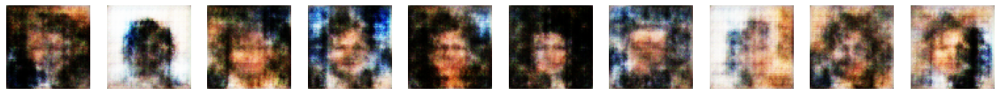

2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 15ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step 


FID at epoch 1: 357.46280148156416

500/500 ━━━━━━━━━━━━━━━━━━━━ 90s 92ms/step - c_acc: 97.6438 - c_gp: 2.0567 - c_loss: -46.9170 - c_wass_loss: -67.4836 - g_acc: 20.9312 - g_loss: -11.1004 - fid: 357.4628
Epoch 2/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 97.4750 - c_gp: 0.2260 - c_loss: -12.4480 - c_wass_loss: -14.7081 - g_acc: 5.8219 - g_loss: -59.1065
Saved to ./output/generated_img_001.png


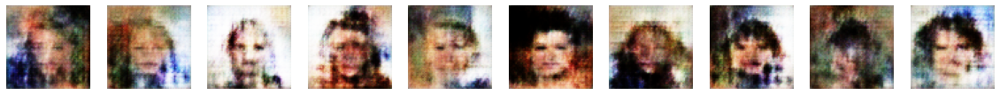

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 2: 363.7589881972708

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 97.4750 - c_gp: 0.2259 - c_loss: -12.4458 - c_wass_loss: -14.7051 - g_acc: 5.8219 - g_loss: -59.0851 - fid: 363.7590
Epoch 3/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 76.4094 - c_gp: 0.1393 - c_loss: -9.1880 - c_wass_loss: -10.5810 - g_acc: 34.5938 - g_loss: -10.2652
Saved to ./output/generated_img_002.png


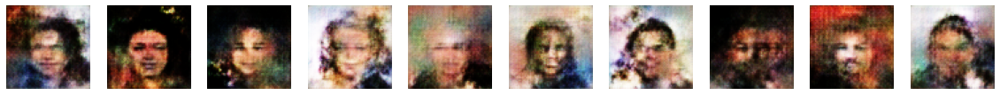

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 3: 330.00286257874694

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 76.4094 - c_gp: 0.1393 - c_loss: -9.1867 - c_wass_loss: -10.5793 - g_acc: 34.5938 - g_loss: -10.2678 - fid: 330.0029
Epoch 4/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 93.9281 - c_gp: 0.0966 - c_loss: -8.0483 - c_wass_loss: -9.0139 - g_acc: 8.9250 - g_loss: -43.6863
Saved to ./output/generated_img_003.png


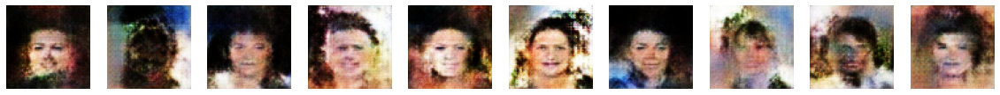

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 4: 322.8272760625575

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 63ms/step - c_acc: 93.9281 - c_gp: 0.0965 - c_loss: -8.0471 - c_wass_loss: -9.0125 - g_acc: 8.9250 - g_loss: -43.6836 - fid: 322.8273
Epoch 5/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 91.0188 - c_gp: 0.0780 - c_loss: -6.5610 - c_wass_loss: -7.3413 - g_acc: 12.8000 - g_loss: -30.6137
Saved to ./output/generated_img_004.png


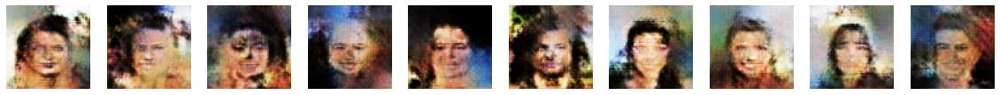

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 5: 296.9767664053186

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 91.0188 - c_gp: 0.0780 - c_loss: -6.5610 - c_wass_loss: -7.3413 - g_acc: 12.8000 - g_loss: -30.6291 - fid: 296.9768
Epoch 6/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 86.4500 - c_gp: 0.0687 - c_loss: -5.9396 - c_wass_loss: -6.6263 - g_acc: 18.5219 - g_loss: -22.7116
Saved to ./output/generated_img_005.png


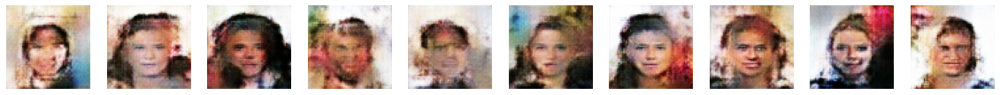

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 6: 267.91316022228204

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 86.4500 - c_gp: 0.0687 - c_loss: -5.9392 - c_wass_loss: -6.6259 - g_acc: 18.5219 - g_loss: -22.7240 - fid: 267.9132
Epoch 7/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - c_acc: 64.3743 - c_gp: 0.0655 - c_loss: -5.3687 - c_wass_loss: -6.0233 - g_acc: 42.3837 - g_loss: 4.0666
Saved to ./output/generated_img_006.png


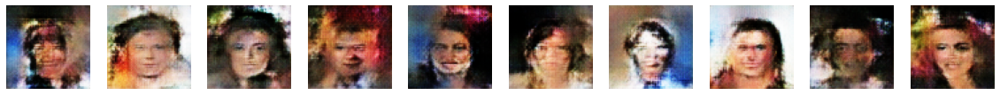

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 7: 259.0074742700374

500/500 ━━━━━━━━━━━━━━━━━━━━ 69s 139ms/step - c_acc: 64.3743 - c_gp: 0.0655 - c_loss: -5.3689 - c_wass_loss: -6.0234 - g_acc: 42.3837 - g_loss: 4.0483 - fid: 259.0075
Epoch 8/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 86.8156 - c_gp: 0.0599 - c_loss: -5.2420 - c_wass_loss: -5.8414 - g_acc: 17.1094 - g_loss: -48.0052
Saved to ./output/generated_img_007.png


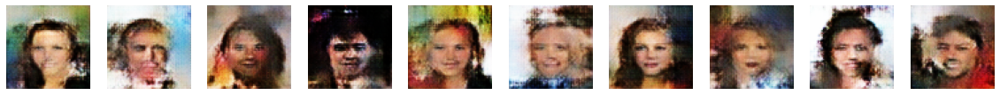

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 8: 241.24810054990746

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 63ms/step - c_acc: 86.8156 - c_gp: 0.0599 - c_loss: -5.2417 - c_wass_loss: -5.8412 - g_acc: 17.1094 - g_loss: -47.9766 - fid: 241.2481
Epoch 9/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 78.6906 - c_gp: 0.0522 - c_loss: -4.8181 - c_wass_loss: -5.3406 - g_acc: 26.3375 - g_loss: -18.8262
Saved to ./output/generated_img_008.png


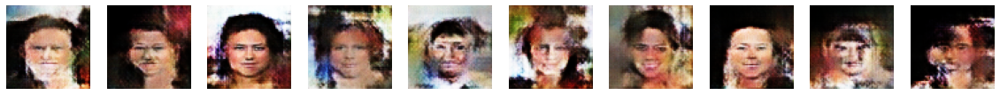

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 9: 243.99645938875662

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 78.6906 - c_gp: 0.0522 - c_loss: -4.8179 - c_wass_loss: -5.3403 - g_acc: 26.3375 - g_loss: -18.8305 - fid: 243.9965
Epoch 10/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 86.6188 - c_gp: 0.0540 - c_loss: -5.0325 - c_wass_loss: -5.5725 - g_acc: 16.4500 - g_loss: -41.2981
Saved to ./output/generated_img_009.png


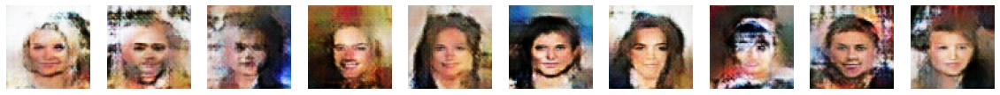

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 10: 240.7077134545795

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 86.6188 - c_gp: 0.0540 - c_loss: -5.0323 - c_wass_loss: -5.5722 - g_acc: 16.4500 - g_loss: -41.2998 - fid: 240.7077
Epoch 11/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 62.1625 - c_gp: 0.0433 - c_loss: -4.9009 - c_wass_loss: -5.3341 - g_acc: 40.5250 - g_loss: -11.4080
Saved to ./output/generated_img_010.png


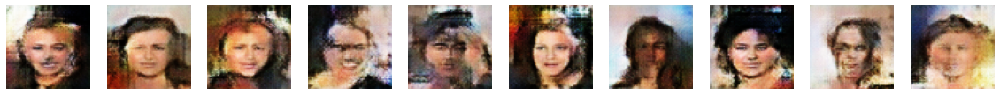

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 11: 210.1035999633012

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 62.1625 - c_gp: 0.0433 - c_loss: -4.9008 - c_wass_loss: -5.3340 - g_acc: 40.5250 - g_loss: -11.4227 - fid: 210.1036
Epoch 12/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 67.8594 - c_gp: 0.0410 - c_loss: -4.3312 - c_wass_loss: -4.7416 - g_acc: 36.3438 - g_loss: -4.0184
Saved to ./output/generated_img_011.png


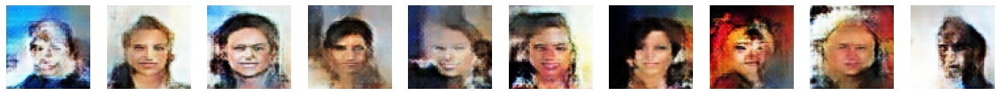

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 12: 236.74491534422137

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 67.8594 - c_gp: 0.0410 - c_loss: -4.3313 - c_wass_loss: -4.7417 - g_acc: 36.3438 - g_loss: -4.0394 - fid: 236.7449
Epoch 13/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 70.1115 - c_gp: 0.0423 - c_loss: -4.5131 - c_wass_loss: -4.9362 - g_acc: 32.9598 - g_loss: -22.0854
Saved to ./output/generated_img_012.png


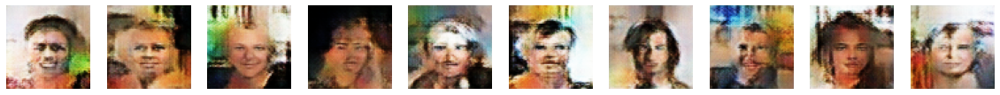

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 13: 226.7987414998923

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 70.1115 - c_gp: 0.0423 - c_loss: -4.5138 - c_wass_loss: -4.9369 - g_acc: 32.9598 - g_loss: -22.0886 - fid: 226.7987
Epoch 14/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 47.9406 - c_gp: 0.0358 - c_loss: -4.7296 - c_wass_loss: -5.0877 - g_acc: 55.3625 - g_loss: -16.1028
Saved to ./output/generated_img_013.png


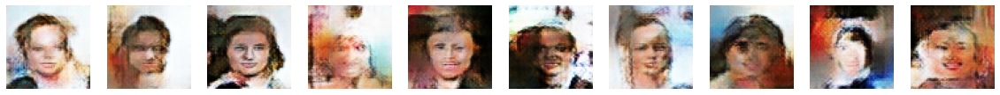

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 14: 225.49479525353763

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 65ms/step - c_acc: 47.9406 - c_gp: 0.0358 - c_loss: -4.7287 - c_wass_loss: -5.0868 - g_acc: 55.3625 - g_loss: -16.0659 - fid: 225.4948
Epoch 15/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 82.2719 - c_gp: 0.0406 - c_loss: -4.0136 - c_wass_loss: -4.4196 - g_acc: 19.0406 - g_loss: -44.4862
Saved to ./output/generated_img_014.png


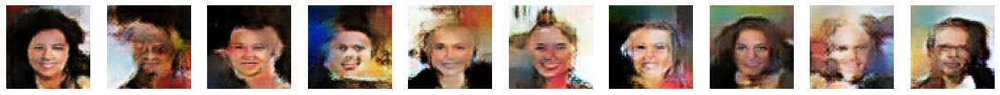

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 15: 208.43593432924976

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 82.2719 - c_gp: 0.0406 - c_loss: -4.0129 - c_wass_loss: -4.4188 - g_acc: 19.0406 - g_loss: -44.4928 - fid: 208.4359
Epoch 16/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 49.6531 - c_gp: 0.0351 - c_loss: -4.1670 - c_wass_loss: -4.5182 - g_acc: 53.6031 - g_loss: 5.1876
Saved to ./output/generated_img_015.png


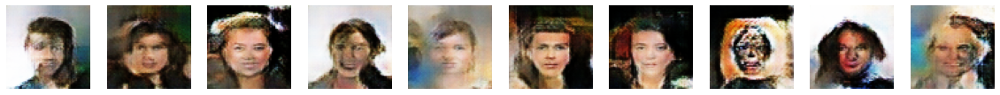

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 16: 208.05275600220273

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 49.6531 - c_gp: 0.0351 - c_loss: -4.1669 - c_wass_loss: -4.5180 - g_acc: 53.6031 - g_loss: 5.1799 - fid: 208.0528
Epoch 17/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 44.7531 - c_gp: 0.0336 - c_loss: -4.1258 - c_wass_loss: -4.4614 - g_acc: 57.2562 - g_loss: -21.6549
Saved to ./output/generated_img_016.png


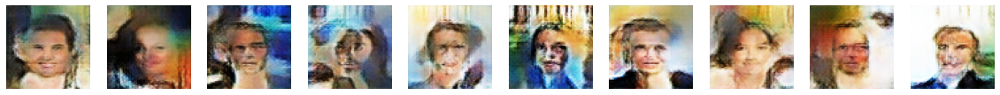

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 17: 217.68717591857748

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 65ms/step - c_acc: 44.7531 - c_gp: 0.0336 - c_loss: -4.1262 - c_wass_loss: -4.4618 - g_acc: 57.2562 - g_loss: -21.5641 - fid: 217.6872
Epoch 18/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 36.9781 - c_gp: 0.0305 - c_loss: -2.9708 - c_wass_loss: -3.2753 - g_acc: 65.5062 - g_loss: 3.4216
Saved to ./output/generated_img_017.png


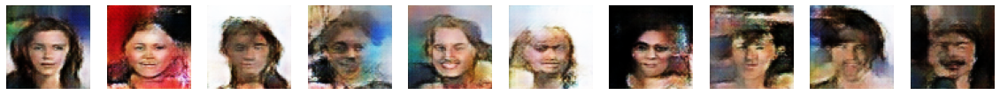

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 18: 209.23811209830143

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 36.9781 - c_gp: 0.0305 - c_loss: -2.9711 - c_wass_loss: -3.2757 - g_acc: 65.5062 - g_loss: 3.4618 - fid: 209.2381
Epoch 19/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 79.3502 - c_gp: 0.0308 - c_loss: -3.5321 - c_wass_loss: -3.8403 - g_acc: 23.7364 - g_loss: -20.3050
Saved to ./output/generated_img_018.png


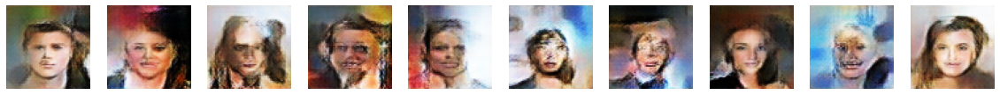

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 19: 198.33404884136334

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 70ms/step - c_acc: 79.3502 - c_gp: 0.0308 - c_loss: -3.5325 - c_wass_loss: -3.8407 - g_acc: 23.7364 - g_loss: -20.3256 - fid: 198.3340
Epoch 20/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 74.7344 - c_gp: 0.0277 - c_loss: -3.2511 - c_wass_loss: -3.5286 - g_acc: 29.7625 - g_loss: -24.0222
Saved to ./output/generated_img_019.png


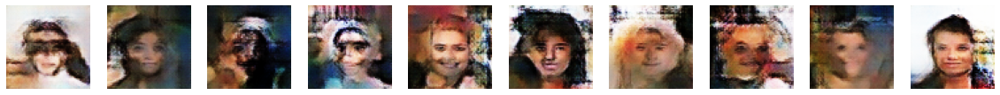

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 20: 211.31294257949148

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 74.7344 - c_gp: 0.0277 - c_loss: -3.2515 - c_wass_loss: -3.5290 - g_acc: 29.7625 - g_loss: -24.0076 - fid: 211.3129
Epoch 21/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 61.1312 - c_gp: 0.0246 - c_loss: -2.9762 - c_wass_loss: -3.2223 - g_acc: 41.5062 - g_loss: -4.6520
Saved to ./output/generated_img_020.png


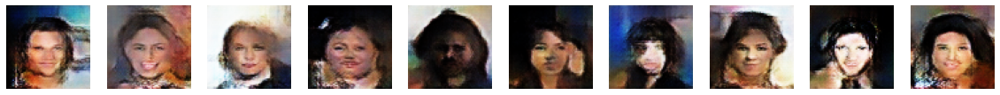

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 21: 208.81526759120734

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 61.1312 - c_gp: 0.0246 - c_loss: -2.9766 - c_wass_loss: -3.2228 - g_acc: 41.5062 - g_loss: -4.6705 - fid: 208.8153
Epoch 22/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 60.8438 - c_gp: 0.0279 - c_loss: -3.5536 - c_wass_loss: -3.8330 - g_acc: 40.7375 - g_loss: -9.6054
Saved to ./output/generated_img_021.png


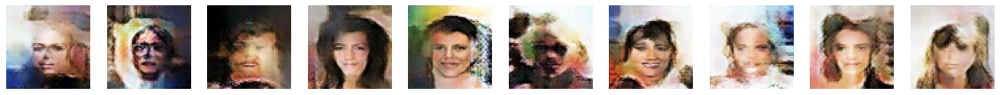

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 22: 205.56937966565084

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 60.8438 - c_gp: 0.0279 - c_loss: -3.5528 - c_wass_loss: -3.8322 - g_acc: 40.7375 - g_loss: -9.6115 - fid: 205.5694
Epoch 23/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 39.5719 - c_gp: 0.0245 - c_loss: -2.9821 - c_wass_loss: -3.2276 - g_acc: 61.8844 - g_loss: -14.9052
Saved to ./output/generated_img_022.png


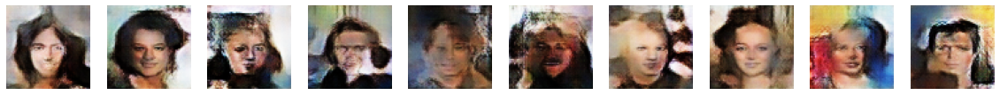

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 23: 199.4888139693118

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 39.5719 - c_gp: 0.0245 - c_loss: -2.9828 - c_wass_loss: -3.2283 - g_acc: 61.8844 - g_loss: -14.8377 - fid: 199.4888
Epoch 24/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - c_acc: 50.3937 - c_gp: 0.0232 - c_loss: -3.6370 - c_wass_loss: -3.8686 - g_acc: 52.7938 - g_loss: 21.4090
Saved to ./output/generated_img_023.png


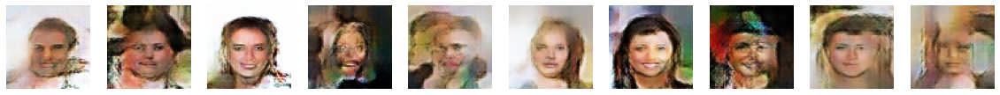

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 24: 204.54724406696704

500/500 ━━━━━━━━━━━━━━━━━━━━ 39s 77ms/step - c_acc: 50.3937 - c_gp: 0.0232 - c_loss: -3.6365 - c_wass_loss: -3.8681 - g_acc: 52.7938 - g_loss: 21.3847 - fid: 204.5472
Epoch 25/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 56.1937 - c_gp: 0.0226 - c_loss: -3.2068 - c_wass_loss: -3.4323 - g_acc: 46.5250 - g_loss: -8.7654
Saved to ./output/generated_img_024.png


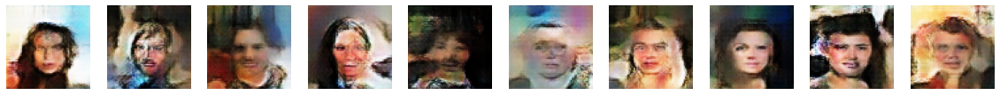

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 25: 192.37942366422558

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 56.1937 - c_gp: 0.0226 - c_loss: -3.2064 - c_wass_loss: -3.4320 - g_acc: 46.5250 - g_loss: -8.7522 - fid: 192.3794
Epoch 26/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 30.8151 - c_gp: 0.0255 - c_loss: -3.4125 - c_wass_loss: -3.6675 - g_acc: 72.6692 - g_loss: 42.6265
Saved to ./output/generated_img_025.png


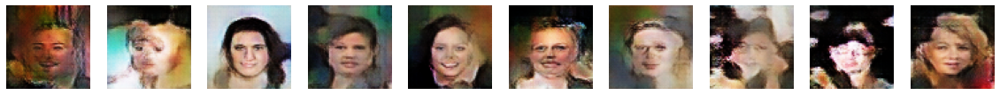

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 26: 176.3685268667497

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 30.8151 - c_gp: 0.0255 - c_loss: -3.4123 - c_wass_loss: -3.6673 - g_acc: 72.6692 - g_loss: 42.5941 - fid: 176.3685
Epoch 27/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 50.3844 - c_gp: 0.0224 - c_loss: -2.7766 - c_wass_loss: -3.0004 - g_acc: 53.2313 - g_loss: -0.7559
Saved to ./output/generated_img_026.png


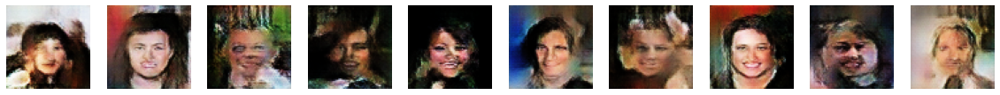

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 27: 194.09124700823003

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 69ms/step - c_acc: 50.3844 - c_gp: 0.0224 - c_loss: -2.7765 - c_wass_loss: -3.0002 - g_acc: 53.2313 - g_loss: -0.7443 - fid: 194.0912
Epoch 28/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 81.5375 - c_gp: 0.0290 - c_loss: -3.4040 - c_wass_loss: -3.6944 - g_acc: 20.5031 - g_loss: -21.8037
Saved to ./output/generated_img_027.png


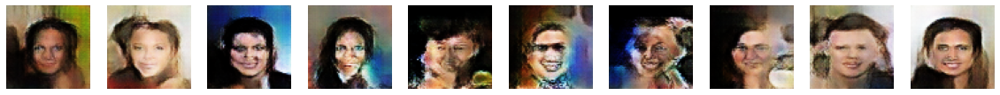

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 28: 178.35875012101295

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 81.5375 - c_gp: 0.0290 - c_loss: -3.4033 - c_wass_loss: -3.6936 - g_acc: 20.5031 - g_loss: -21.8571 - fid: 178.3588
Epoch 29/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 55.3844 - c_gp: 0.0247 - c_loss: -2.7406 - c_wass_loss: -2.9874 - g_acc: 46.9500 - g_loss: -44.9901
Saved to ./output/generated_img_028.png


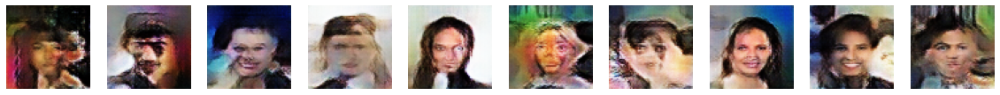

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 29: 181.99946586479115

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 55.3844 - c_gp: 0.0247 - c_loss: -2.7409 - c_wass_loss: -2.9877 - g_acc: 46.9500 - g_loss: -44.9221 - fid: 181.9995
Epoch 30/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 41.6344 - c_gp: 0.0220 - c_loss: -3.6813 - c_wass_loss: -3.9014 - g_acc: 60.3281 - g_loss: 23.6708
Saved to ./output/generated_img_029.png


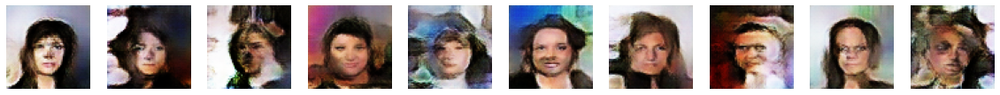

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 30: 165.55054110704873

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 72ms/step - c_acc: 41.6344 - c_gp: 0.0220 - c_loss: -3.6799 - c_wass_loss: -3.8999 - g_acc: 60.3281 - g_loss: 23.6526 - fid: 165.5505
Epoch 31/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 70.5188 - c_gp: 0.0215 - c_loss: -3.2705 - c_wass_loss: -3.4853 - g_acc: 31.3125 - g_loss: -8.5135
Saved to ./output/generated_img_030.png


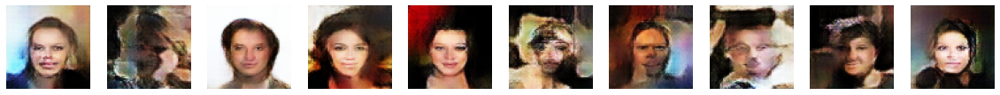

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 31: 184.3715204807394

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 67ms/step - c_acc: 70.5188 - c_gp: 0.0215 - c_loss: -3.2703 - c_wass_loss: -3.4851 - g_acc: 31.3125 - g_loss: -8.5612 - fid: 184.3715
Epoch 32/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 46.4073 - c_gp: 0.0234 - c_loss: -2.6376 - c_wass_loss: -2.8720 - g_acc: 55.3163 - g_loss: -16.1391
Saved to ./output/generated_img_031.png


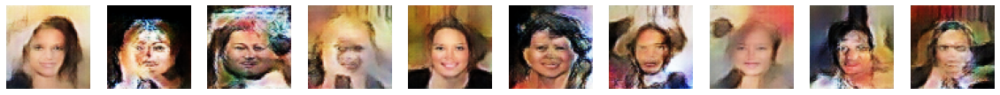

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 32: 188.94699468574694

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 46.4073 - c_gp: 0.0234 - c_loss: -2.6377 - c_wass_loss: -2.8721 - g_acc: 55.3163 - g_loss: -16.0912 - fid: 188.9470
Epoch 33/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 57.3969 - c_gp: 0.0171 - c_loss: -2.3036 - c_wass_loss: -2.4748 - g_acc: 44.4875 - g_loss: -17.0757
Saved to ./output/generated_img_032.png


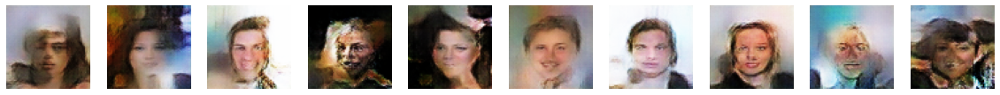

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 33: 186.06844418873962

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 71ms/step - c_acc: 57.3969 - c_gp: 0.0171 - c_loss: -2.3048 - c_wass_loss: -2.4760 - g_acc: 44.4875 - g_loss: -17.0618 - fid: 186.0684
Epoch 34/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 81.7688 - c_gp: 0.0205 - c_loss: -1.1548 - c_wass_loss: -1.3603 - g_acc: 19.4031 - g_loss: -45.3706
Saved to ./output/generated_img_033.png


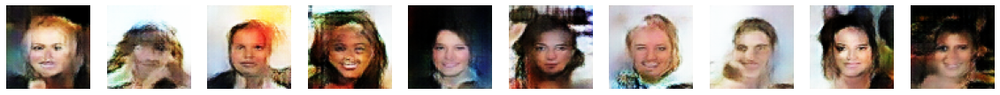

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 34: 191.19195190289085

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 67ms/step - c_acc: 81.7688 - c_gp: 0.0206 - c_loss: -1.1567 - c_wass_loss: -1.3622 - g_acc: 19.4031 - g_loss: -45.3810 - fid: 191.1920
Epoch 35/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 36.9156 - c_gp: 0.0215 - c_loss: -2.9258 - c_wass_loss: -3.1407 - g_acc: 65.7906 - g_loss: 1.3689
Saved to ./output/generated_img_034.png


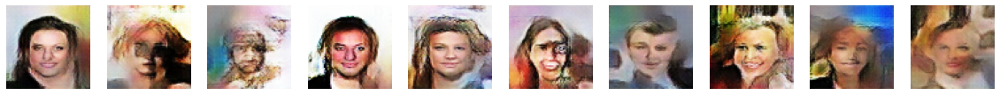

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 35: 177.5795087095461

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 36.9156 - c_gp: 0.0215 - c_loss: -2.9252 - c_wass_loss: -3.1401 - g_acc: 65.7906 - g_loss: 1.4015 - fid: 177.5795
Epoch 36/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 77.3031 - c_gp: 0.0259 - c_loss: -2.9105 - c_wass_loss: -3.1696 - g_acc: 24.6594 - g_loss: -39.7560
Saved to ./output/generated_img_035.png


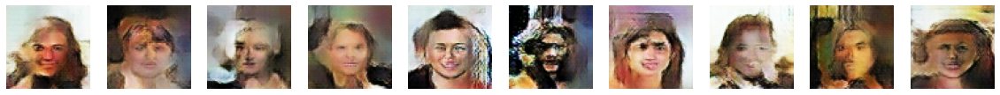

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 36: 178.250446957542

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 77.3031 - c_gp: 0.0259 - c_loss: -2.9103 - c_wass_loss: -3.1694 - g_acc: 24.6594 - g_loss: -39.7489 - fid: 178.2504
Epoch 37/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 16.4875 - c_gp: 0.0237 - c_loss: -3.7054 - c_wass_loss: -3.9420 - g_acc: 84.3844 - g_loss: 71.6840
Saved to ./output/generated_img_036.png


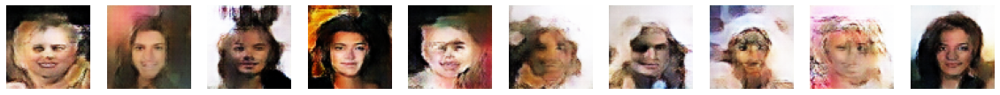

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 37: 171.2705955814203

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 71ms/step - c_acc: 16.4875 - c_gp: 0.0237 - c_loss: -3.7037 - c_wass_loss: -3.9403 - g_acc: 84.3844 - g_loss: 71.7806 - fid: 171.2706
Epoch 38/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 40.1567 - c_gp: 0.0243 - c_loss: -2.8838 - c_wass_loss: -3.1272 - g_acc: 60.9768 - g_loss: 88.0599
Saved to ./output/generated_img_037.png


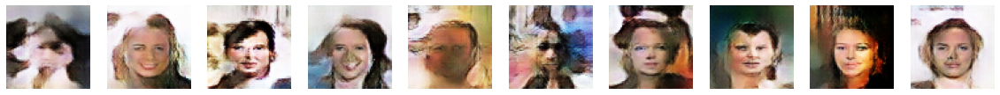

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 38: 165.05831102788517

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 67ms/step - c_acc: 40.1567 - c_gp: 0.0243 - c_loss: -2.8841 - c_wass_loss: -3.1274 - g_acc: 60.9768 - g_loss: 87.9251 - fid: 165.0583
Epoch 39/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 87.2094 - c_gp: 0.0188 - c_loss: -2.1855 - c_wass_loss: -2.3734 - g_acc: 13.6781 - g_loss: -105.5603
Saved to ./output/generated_img_038.png


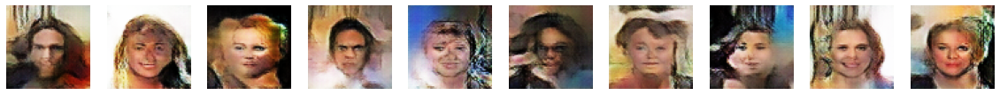

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 39: 184.485273795112

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 87.2094 - c_gp: 0.0188 - c_loss: -2.1855 - c_wass_loss: -2.3734 - g_acc: 13.6781 - g_loss: -105.5343 - fid: 184.4853
Epoch 40/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 10.6844 - c_gp: 0.0210 - c_loss: -2.2370 - c_wass_loss: -2.4469 - g_acc: 89.8938 - g_loss: 54.4422
Saved to ./output/generated_img_039.png


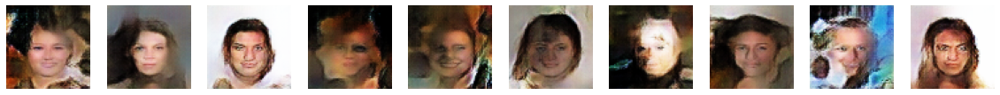

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 40: 166.38036003319212

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 10.6844 - c_gp: 0.0210 - c_loss: -2.2369 - c_wass_loss: -2.4468 - g_acc: 89.8938 - g_loss: 54.5175 - fid: 166.3804


In [18]:
FID_metric = FIDCallback(real_images=train_data, latent_dim=Z_DIM)

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), FID_metric, loss_history],
)

In [19]:
# Save the final models
generator.save("./models/generator_base.keras")
critic.save("./models/critic_base.keras")

## Generate Images

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


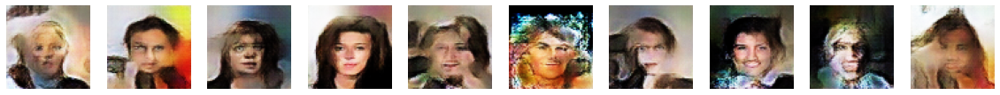

In [20]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)

In [21]:
import matplotlib.pyplot as plt

def plot_losses_and_accuracy(loss_history):
    epochs = len(loss_history.history['c_loss'])
    x = range(epochs)

    fig, axs = plt.subplots(2, 2, figsize=(14, 10))
    
    axs[0, 0].plot(x, loss_history.history['c_loss'], "o-", label="Critic Loss", color="coral", alpha=0.7)
    axs[0, 0].set(xlabel="Epochs", ylabel="Loss")
    axs[0, 0].legend()
    
    axs[0, 1].plot(x, loss_history.history['g_loss'], "o-",label="Generator Loss", color="brown", alpha=0.7)
    axs[0, 1].set(xlabel="Epochs", ylabel="Loss")
    axs[0, 1].legend()
    
    axs[1, 0].plot(x, loss_history.history['c_acc'], "o-",label="Critic Accuracy" , color="forestgreen", alpha=0.7)
    axs[1, 0].set(xlabel="Epochs", ylabel="Accuracy")
    axs[1, 0].legend()
    
    axs[1, 1].plot(x, loss_history.history['g_acc'], "o-",label="Generator Accuracy", color="seagreen", alpha=0.7)
    axs[1, 1].set(xlabel="Epochs", ylabel="Accuracy")
    axs[1, 1].legend()

    plt.show()

    fig = plt.figure(figsize=(14, 5))
    plt.plot(x, loss_history.history['fid'], "o-",label="FID", color="steelblue", alpha=0.6)
    plt.xlabel("Epochs")
    plt.ylabel("FID")
    plt.legend()
    plt.show()


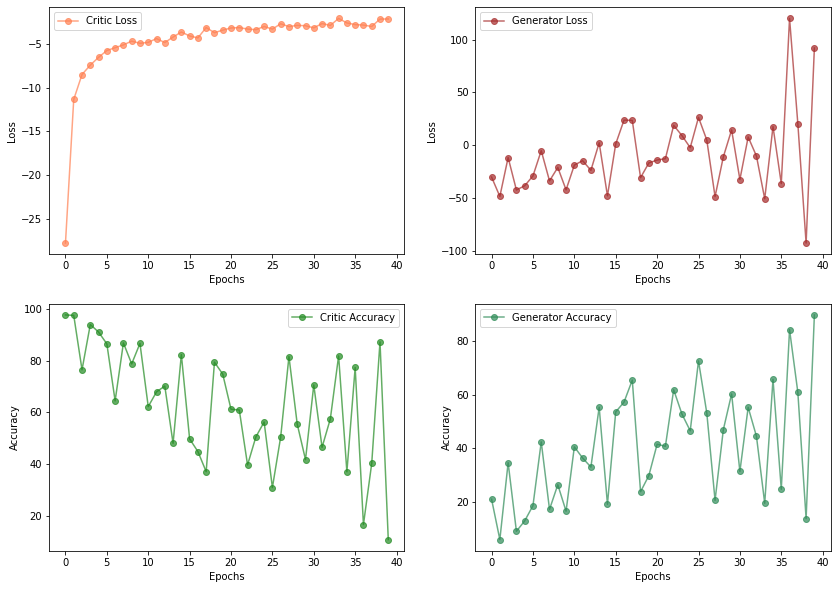

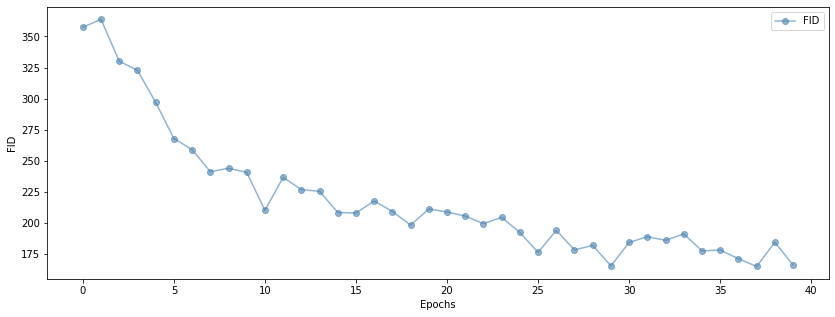

In [22]:
plot_losses_and_accuracy(loss_history)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results discussion**

After training this baseline WGAN-GP, we can observe that the GAN has successfully generated images imitating the distribution of human faces. Quantitatively, it can be seen that the measured FID improves with each epoch, plateauing at the end and reaching a value of **166.38**. On the other hand, the accuracy of the discriminator and the generator are quite oscillating. A qualitative analysis of the images shows that, although it can be distinguished that it tries to generate faces, they are far from being accurate. Artifacts and strange elements can be observed, with images that are not entirely clear and sometimes do not appear to be faces.

One of the hypotheses is that, after analyzing the architecture of the GAN, it was noted that the Critic uses a lot of Dropout layers, perhaps excessively. **Excessive dropout** in the Critic of a WGAN-GP can lead to several issues, such as loss of essential information, noisy and inconsistent gradients, unstable training, reduced modeling capacity, and over-regularization. High dropout rates deactivate a significant number of neurons, impairing the Critic's ability to differentiate between real and generated images. This results in poor performance, as the Critic provides unclear gradient signals to the Generator, causing oscillations in training.

Therefore, our next step is to remove various Dropout layers, leaving only one layer with a Dropout of **0.2** at the end of the Critic.


</div>

## **Less DropOut on the Critic**

## 2. Build the WGAN-GP with a stroger Critic -> Less DropOut<a name="build"></a>

In [9]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.2)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 3)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d (Conv2D)                 │ (None, 32, 32, 64)        │      3,136 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_1 (Conv2D)               │ (None, 16, 16, 128)       │    131,200 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_2 (Conv2D)               │ (None, 8, 8, 256)         │    524,544 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 256)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_3 (Conv2D)               │ (None, 4, 4, 512)         │  2,097,664 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dropout (Dropout)               │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_4 (Conv2D)               │ (None, 1, 1, 1)           │      8,193 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ flatten (Flatten)               │ (None, 1)                 │          0 │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 2,764,737 (10.55 MB)

 Trainable params: 2,764,737 (10.55 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(512, kernel_size=4, strides=1, padding="valid", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding="same", use_bias=False)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh")(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ reshape (Reshape)               │ (None, 1, 1, 128)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose                │ (None, 4, 4, 512)         │  1,048,576 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization             │ (None, 4, 4, 512)         │      2,048 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 4, 4, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_1              │ (None, 8, 8, 256)         │  2,097,152 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_1           │ (None, 8, 8, 256)         │      1,024 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 8, 8, 256)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_2              │ (None, 16, 16, 128)       │    524,288 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_2           │ (None, 16, 16, 128)       │        512 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 16, 16, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_3              │ (None, 32, 32, 64)        │    131,072 │
│ (Conv2DTranspose)               │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_3           │ (None, 32, 32, 64)        │        256 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 32, 32, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_transpose_4              │ (None, 64, 64, 3)         │      3,075 │
│ (Conv2DTranspose)               │                           │            │
└─────────────────────────────────┴───────────────────────────┴────────────┘

 Total params: 3,808,003 (14.53 MB)

 Trainable params: 3,806,083 (14.52 MB)

 Non-trainable params: 1,920 (7.50 KB)

In [12]:
# Create a GAN
wgangp = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

## 3. Train the GAN <a name="train"></a>

In [14]:
# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

In [16]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.weights.h5",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")

Epoch 1/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 96.7125 - c_gp: 2.1448 - c_loss: -50.6021 - c_wass_loss: -72.0497 - g_acc: 26.1375 - g_loss: -5.6311
Saved to ./output/generated_img_000.png


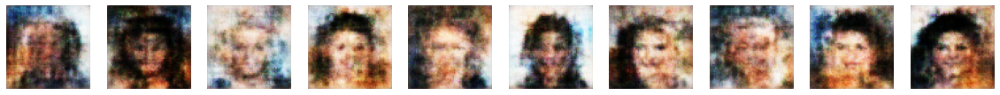

2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step 


FID at epoch 1: 353.31218615692376

500/500 ━━━━━━━━━━━━━━━━━━━━ 85s 128ms/step - c_acc: 96.7125 - c_gp: 2.1425 - c_loss: -50.5611 - c_wass_loss: -71.9865 - g_acc: 26.1375 - g_loss: -5.6791 - fid: 353.3122
Epoch 2/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 99.7906 - c_gp: 0.2415 - c_loss: -13.6775 - c_wass_loss: -16.0922 - g_acc: 0.6625 - g_loss: -88.3370
Saved to ./output/generated_img_001.png


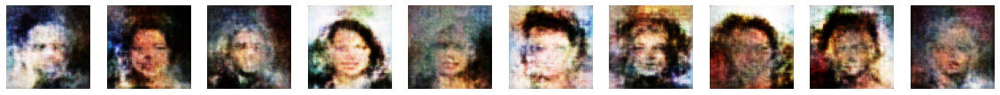

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 2: 376.82019739416376

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 69ms/step - c_acc: 99.7906 - c_gp: 0.2414 - c_loss: -13.6763 - c_wass_loss: -16.0906 - g_acc: 0.6625 - g_loss: -88.3272 - fid: 376.8202
Epoch 3/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 97.4313 - c_gp: 0.1868 - c_loss: -11.6416 - c_wass_loss: -13.5098 - g_acc: 4.7063 - g_loss: -51.2519
Saved to ./output/generated_img_002.png


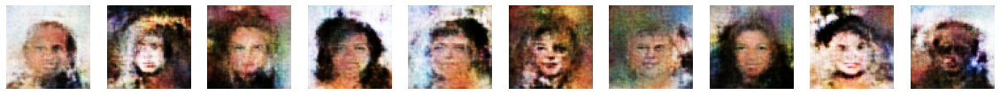

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 3: 341.167867408661

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 97.4313 - c_gp: 0.1868 - c_loss: -11.6401 - c_wass_loss: -13.5078 - g_acc: 4.7063 - g_loss: -51.2610 - fid: 341.1679
Epoch 4/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 94.0813 - c_gp: 0.1281 - c_loss: -8.7630 - c_wass_loss: -10.0435 - g_acc: 9.0156 - g_loss: -52.0980
Saved to ./output/generated_img_003.png


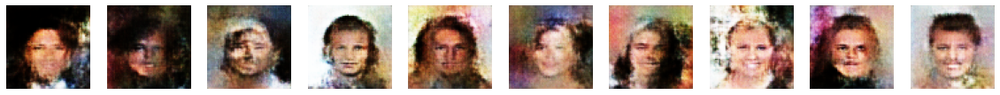

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 4: 320.10469180585386

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 94.0813 - c_gp: 0.1280 - c_loss: -8.7627 - c_wass_loss: -10.0431 - g_acc: 9.0156 - g_loss: -52.0911 - fid: 320.1047
Epoch 5/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 75.8187 - c_gp: 0.1135 - c_loss: -8.5282 - c_wass_loss: -9.6634 - g_acc: 31.3219 - g_loss: -36.7144
Saved to ./output/generated_img_004.png


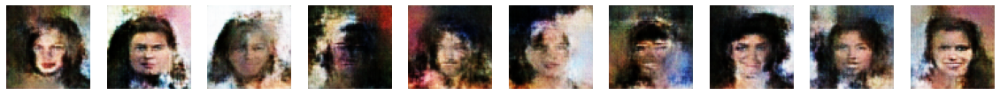

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 5: 282.355146467921

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 65ms/step - c_acc: 75.8187 - c_gp: 0.1135 - c_loss: -8.5277 - c_wass_loss: -9.6630 - g_acc: 31.3219 - g_loss: -36.6877 - fid: 282.3551
Epoch 6/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 83.6062 - c_gp: 0.1095 - c_loss: -8.0027 - c_wass_loss: -9.0978 - g_acc: 28.4719 - g_loss: -14.8530
Saved to ./output/generated_img_005.png


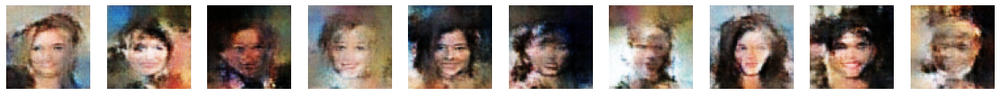

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 6: 267.73797352005664

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 83.6062 - c_gp: 0.1095 - c_loss: -8.0029 - c_wass_loss: -9.0980 - g_acc: 28.4719 - g_loss: -14.8502 - fid: 267.7380
Epoch 7/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - c_acc: 78.6616 - c_gp: 0.1125 - c_loss: -8.3923 - c_wass_loss: -9.5176 - g_acc: 39.0256 - g_loss: -8.8779
Saved to ./output/generated_img_006.png


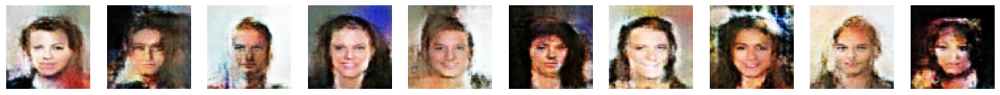

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 7: 239.26623039140094

500/500 ━━━━━━━━━━━━━━━━━━━━ 47s 95ms/step - c_acc: 78.6616 - c_gp: 0.1125 - c_loss: -8.3926 - c_wass_loss: -9.5179 - g_acc: 39.0256 - g_loss: -8.8705 - fid: 239.2662
Epoch 8/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 59.4875 - c_gp: 0.1172 - c_loss: -8.4813 - c_wass_loss: -9.6533 - g_acc: 62.8781 - g_loss: 1.2713
Saved to ./output/generated_img_007.png


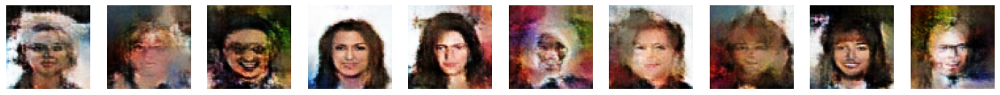

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 8: 244.17080880563626

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 71ms/step - c_acc: 59.4875 - c_gp: 0.1172 - c_loss: -8.4812 - c_wass_loss: -9.6532 - g_acc: 62.8781 - g_loss: 1.2787 - fid: 244.1708
Epoch 9/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 36.2687 - c_gp: 0.1135 - c_loss: -8.5198 - c_wass_loss: -9.6550 - g_acc: 81.3344 - g_loss: 18.0351
Saved to ./output/generated_img_008.png


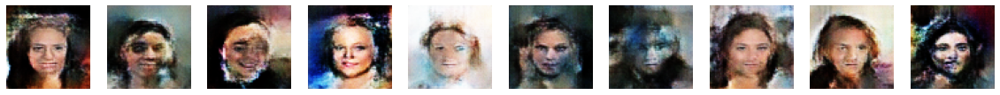

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 9: 235.48271727782165

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 36.2687 - c_gp: 0.1135 - c_loss: -8.5197 - c_wass_loss: -9.6548 - g_acc: 81.3344 - g_loss: 18.0299 - fid: 235.4827
Epoch 10/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 24.0281 - c_gp: 0.1160 - c_loss: -8.2114 - c_wass_loss: -9.3710 - g_acc: 88.6687 - g_loss: 23.2599
Saved to ./output/generated_img_009.png


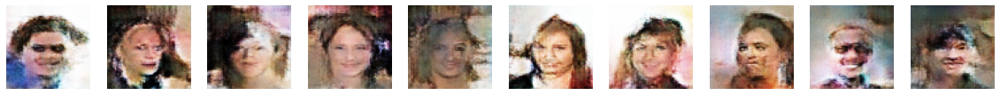

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 10: 212.6565785737772

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 24.0281 - c_gp: 0.1160 - c_loss: -8.2112 - c_wass_loss: -9.3708 - g_acc: 88.6687 - g_loss: 23.2578 - fid: 212.6566
Epoch 11/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 12.3500 - c_gp: 0.1029 - c_loss: -8.1498 - c_wass_loss: -9.1787 - g_acc: 95.6813 - g_loss: 27.9406
Saved to ./output/generated_img_010.png


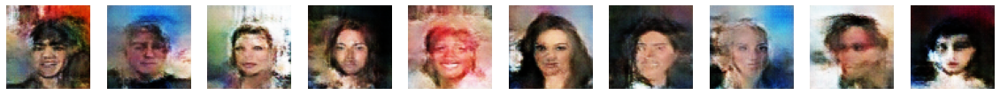

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 11: 209.3198827873007

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 12.3500 - c_gp: 0.1029 - c_loss: -8.1498 - c_wass_loss: -9.1788 - g_acc: 95.6813 - g_loss: 27.9442 - fid: 209.3199
Epoch 12/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 11.6719 - c_gp: 0.1003 - c_loss: -7.9403 - c_wass_loss: -8.9437 - g_acc: 95.2781 - g_loss: 34.3404
Saved to ./output/generated_img_011.png


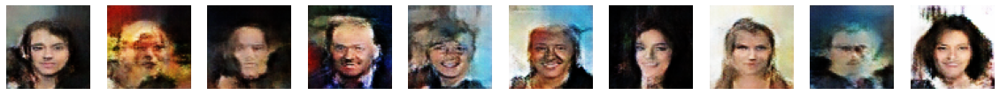

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 12: 201.5963353919026

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 11.6719 - c_gp: 0.1003 - c_loss: -7.9401 - c_wass_loss: -8.9435 - g_acc: 95.2781 - g_loss: 34.3331 - fid: 201.5963
Epoch 13/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 24.2865 - c_gp: 0.0957 - c_loss: -7.7532 - c_wass_loss: -8.7097 - g_acc: 87.1585 - g_loss: 27.7809
Saved to ./output/generated_img_012.png


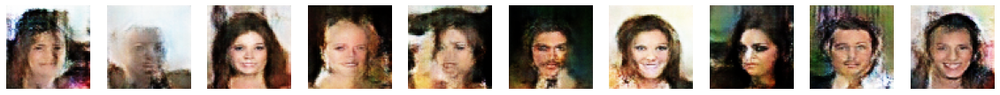

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 13: 199.15709786648546

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 24.2865 - c_gp: 0.0957 - c_loss: -7.7529 - c_wass_loss: -8.7094 - g_acc: 87.1585 - g_loss: 27.7702 - fid: 199.1571
Epoch 14/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 31.7281 - c_gp: 0.0893 - c_loss: -7.2710 - c_wass_loss: -8.1640 - g_acc: 83.1188 - g_loss: 13.6913
Saved to ./output/generated_img_013.png


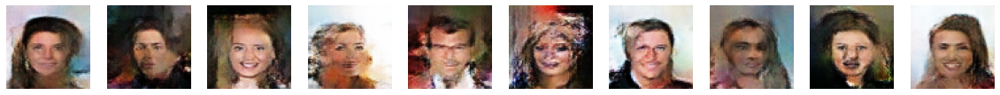

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 14: 188.57587215206632

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 31.7281 - c_gp: 0.0893 - c_loss: -7.2709 - c_wass_loss: -8.1640 - g_acc: 83.1188 - g_loss: 13.6966 - fid: 188.5759
Epoch 15/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 19.1562 - c_gp: 0.0883 - c_loss: -7.0081 - c_wass_loss: -7.8912 - g_acc: 90.1344 - g_loss: 16.9695
Saved to ./output/generated_img_014.png


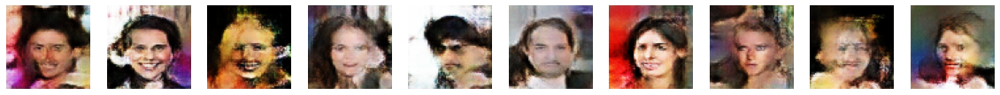

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 15: 197.97282803993963

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 19.1562 - c_gp: 0.0883 - c_loss: -7.0083 - c_wass_loss: -7.8913 - g_acc: 90.1344 - g_loss: 16.9838 - fid: 197.9728
Epoch 16/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 7.2125 - c_gp: 0.0837 - c_loss: -7.0137 - c_wass_loss: -7.8505 - g_acc: 97.0219 - g_loss: 34.5142
Saved to ./output/generated_img_015.png


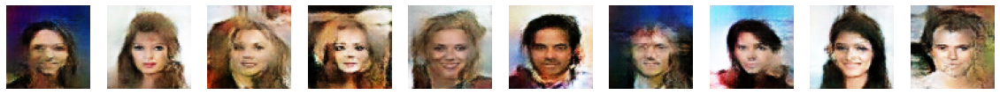

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 16: 187.45561248903482

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 7.2125 - c_gp: 0.0837 - c_loss: -7.0137 - c_wass_loss: -7.8505 - g_acc: 97.0219 - g_loss: 34.5143 - fid: 187.4556
Epoch 17/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 7.1969 - c_gp: 0.0808 - c_loss: -6.8405 - c_wass_loss: -7.6488 - g_acc: 96.7594 - g_loss: 35.1268
Saved to ./output/generated_img_016.png


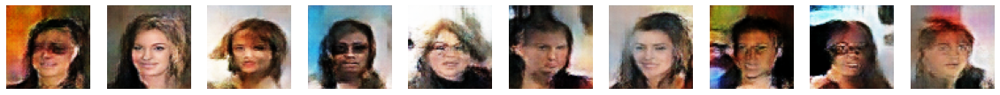

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 17: 187.4096473259275

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 7.1969 - c_gp: 0.0808 - c_loss: -6.8402 - c_wass_loss: -7.6485 - g_acc: 96.7594 - g_loss: 35.1231 - fid: 187.4096
Epoch 18/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 9.3500 - c_gp: 0.0765 - c_loss: -6.6811 - c_wass_loss: -7.4461 - g_acc: 96.3094 - g_loss: 25.9248
Saved to ./output/generated_img_017.png


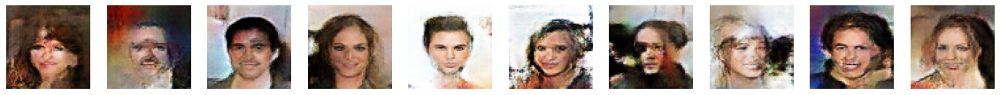

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 18: 179.42806232374443

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 71ms/step - c_acc: 9.3500 - c_gp: 0.0765 - c_loss: -6.6810 - c_wass_loss: -7.4459 - g_acc: 96.3094 - g_loss: 25.9296 - fid: 179.4281
Epoch 19/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 12.9529 - c_gp: 0.0727 - c_loss: -6.6437 - c_wass_loss: -7.3703 - g_acc: 94.0616 - g_loss: 26.3576
Saved to ./output/generated_img_018.png


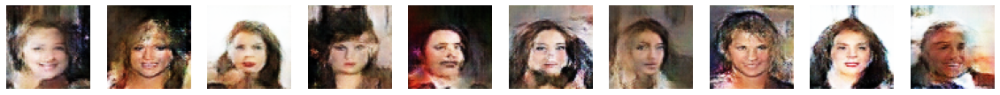

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 19: 189.17875807149483

500/500 ━━━━━━━━━━━━━━━━━━━━ 44s 88ms/step - c_acc: 12.9529 - c_gp: 0.0727 - c_loss: -6.6432 - c_wass_loss: -7.3698 - g_acc: 94.0616 - g_loss: 26.3556 - fid: 189.1788
Epoch 20/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 16.0406 - c_gp: 0.0707 - c_loss: -6.2940 - c_wass_loss: -7.0009 - g_acc: 92.2031 - g_loss: 21.4924
Saved to ./output/generated_img_019.png


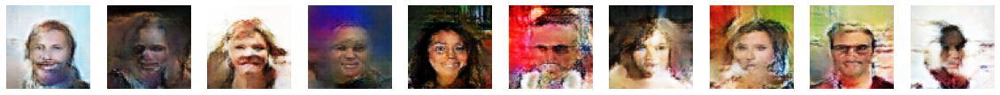

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 20: 192.39627206117183

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 16.0406 - c_gp: 0.0707 - c_loss: -6.2938 - c_wass_loss: -7.0007 - g_acc: 92.2031 - g_loss: 21.4964 - fid: 192.3963
Epoch 21/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 8.7563 - c_gp: 0.0690 - c_loss: -6.3494 - c_wass_loss: -7.0393 - g_acc: 96.0875 - g_loss: 26.8412
Saved to ./output/generated_img_020.png


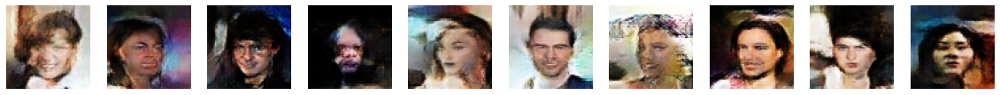

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 21: 187.19843053019318

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 8.7563 - c_gp: 0.0690 - c_loss: -6.3492 - c_wass_loss: -7.0391 - g_acc: 96.0875 - g_loss: 26.8464 - fid: 187.1984
Epoch 22/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 9.7094 - c_gp: 0.0703 - c_loss: -6.3107 - c_wass_loss: -7.0142 - g_acc: 95.2812 - g_loss: 30.8605
Saved to ./output/generated_img_021.png


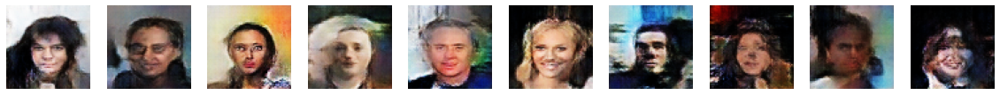

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 22: 184.37622140628065

500/500 ━━━━━━━━━━━━━━━━━━━━ 57s 115ms/step - c_acc: 9.7094 - c_gp: 0.0703 - c_loss: -6.3106 - c_wass_loss: -7.0140 - g_acc: 95.2812 - g_loss: 30.8621 - fid: 184.3762
Epoch 23/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 8.3313 - c_gp: 0.0635 - c_loss: -6.0624 - c_wass_loss: -6.6970 - g_acc: 95.9094 - g_loss: 28.7352
Saved to ./output/generated_img_022.png


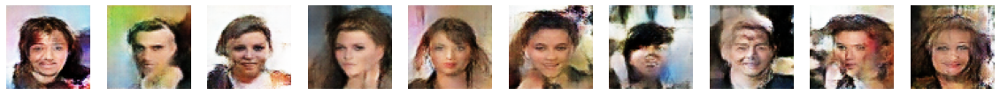

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


FID at epoch 23: 171.36020270804414

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 8.3313 - c_gp: 0.0635 - c_loss: -6.0622 - c_wass_loss: -6.6968 - g_acc: 95.9094 - g_loss: 28.7406 - fid: 171.3602
Epoch 24/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 9.4563 - c_gp: 0.0630 - c_loss: -6.0063 - c_wass_loss: -6.6368 - g_acc: 94.5437 - g_loss: 33.6912
Saved to ./output/generated_img_023.png


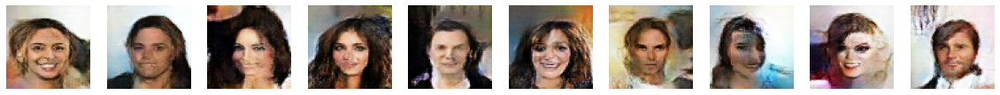

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 24: 164.1536674417166

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 9.4563 - c_gp: 0.0630 - c_loss: -6.0065 - c_wass_loss: -6.6370 - g_acc: 94.5437 - g_loss: 33.6941 - fid: 164.1537
Epoch 25/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 10.5750 - c_gp: 0.0597 - c_loss: -5.9799 - c_wass_loss: -6.5772 - g_acc: 93.9563 - g_loss: 30.6076
Saved to ./output/generated_img_024.png


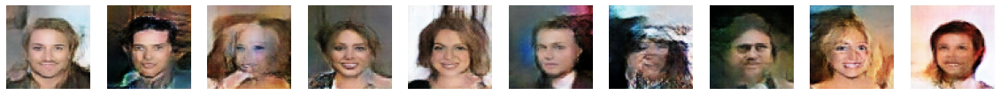

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 25: 159.81744133304267

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 10.5750 - c_gp: 0.0597 - c_loss: -5.9795 - c_wass_loss: -6.5769 - g_acc: 93.9563 - g_loss: 30.6121 - fid: 159.8174
Epoch 26/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 12.0196 - c_gp: 0.0600 - c_loss: -5.5385 - c_wass_loss: -6.1386 - g_acc: 93.4761 - g_loss: 31.8865
Saved to ./output/generated_img_025.png


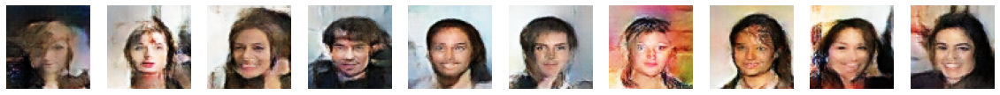

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 26: 174.91460080119484

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 12.0196 - c_gp: 0.0600 - c_loss: -5.5385 - c_wass_loss: -6.1386 - g_acc: 93.4761 - g_loss: 31.8795 - fid: 174.9146
Epoch 27/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 22.4219 - c_gp: 0.0556 - c_loss: -5.8674 - c_wass_loss: -6.4239 - g_acc: 85.5844 - g_loss: 26.6495
Saved to ./output/generated_img_026.png


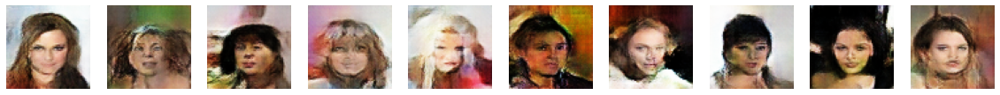

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 27: 165.41960797033028

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 22.4219 - c_gp: 0.0556 - c_loss: -5.8672 - c_wass_loss: -6.4237 - g_acc: 85.5844 - g_loss: 26.6389 - fid: 165.4196
Epoch 28/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 23.0187 - c_gp: 0.0602 - c_loss: -5.8339 - c_wass_loss: -6.4360 - g_acc: 85.2438 - g_loss: 20.7231
Saved to ./output/generated_img_027.png


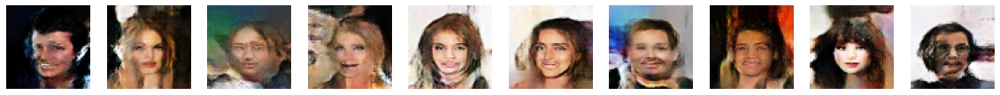

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 28: 157.1625172219513

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 23.0187 - c_gp: 0.0602 - c_loss: -5.8337 - c_wass_loss: -6.4358 - g_acc: 85.2438 - g_loss: 20.7237 - fid: 157.1625
Epoch 29/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - c_acc: 20.9844 - c_gp: 0.0597 - c_loss: -5.7967 - c_wass_loss: -6.3938 - g_acc: 85.0188 - g_loss: 29.8876
Saved to ./output/generated_img_028.png


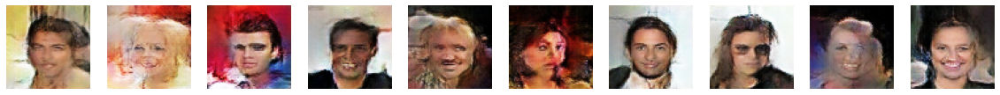

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 29: 168.6222638048925

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 20.9844 - c_gp: 0.0597 - c_loss: -5.7967 - c_wass_loss: -6.3938 - g_acc: 85.0188 - g_loss: 29.8813 - fid: 168.6223
Epoch 30/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 25.4312 - c_gp: 0.0530 - c_loss: -5.3562 - c_wass_loss: -5.8865 - g_acc: 80.9219 - g_loss: 14.7894
Saved to ./output/generated_img_029.png


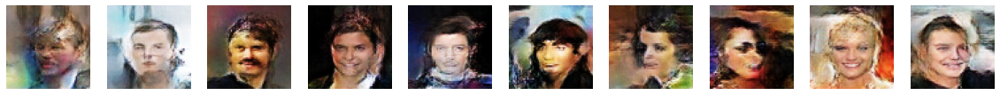

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 30: 158.87220176495345

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 69ms/step - c_acc: 25.4312 - c_gp: 0.0530 - c_loss: -5.3566 - c_wass_loss: -5.8869 - g_acc: 80.9219 - g_loss: 14.8089 - fid: 158.8722
Epoch 31/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 28.9000 - c_gp: 0.0539 - c_loss: -5.4872 - c_wass_loss: -6.0259 - g_acc: 77.2656 - g_loss: 28.2272
Saved to ./output/generated_img_030.png


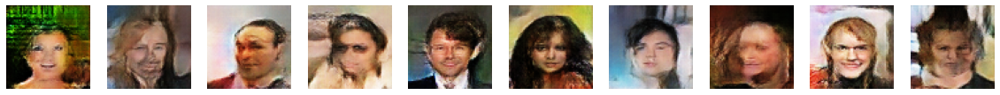

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 31: 157.38594665246129

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 71ms/step - c_acc: 28.9000 - c_gp: 0.0539 - c_loss: -5.4872 - c_wass_loss: -6.0259 - g_acc: 77.2656 - g_loss: 28.2187 - fid: 157.3859
Epoch 32/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 41.6752 - c_gp: 0.0501 - c_loss: -5.2137 - c_wass_loss: -5.7149 - g_acc: 60.9192 - g_loss: 31.7248
Saved to ./output/generated_img_031.png


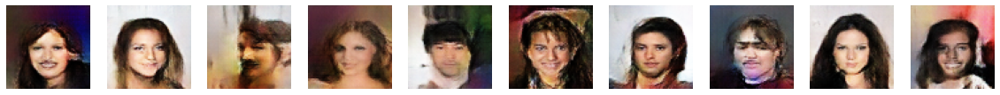

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 32: 158.70587806673774

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 41.6752 - c_gp: 0.0501 - c_loss: -5.2131 - c_wass_loss: -5.7142 - g_acc: 60.9192 - g_loss: 31.6671 - fid: 158.7059
Epoch 33/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 56.1188 - c_gp: 0.0353 - c_loss: -4.9696 - c_wass_loss: -5.3231 - g_acc: 47.5375 - g_loss: -42.8712
Saved to ./output/generated_img_032.png


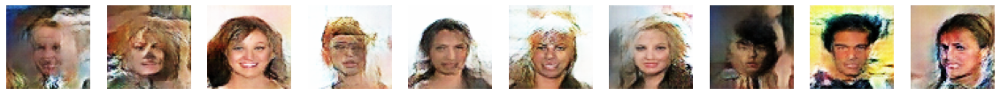

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 33: 147.0350174953624

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 71ms/step - c_acc: 56.1188 - c_gp: 0.0354 - c_loss: -4.9697 - c_wass_loss: -5.3233 - g_acc: 47.5375 - g_loss: -42.8055 - fid: 147.0350
Epoch 34/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 43.0938 - c_gp: 0.0376 - c_loss: -4.3688 - c_wass_loss: -4.7453 - g_acc: 59.2687 - g_loss: 33.2383
Saved to ./output/generated_img_033.png


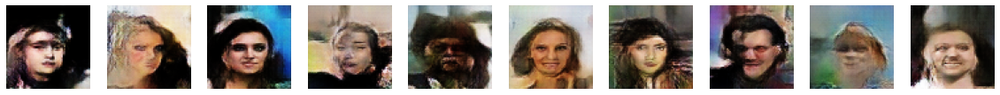

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 34: 155.2009360525182

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 43.0938 - c_gp: 0.0377 - c_loss: -4.3689 - c_wass_loss: -4.7454 - g_acc: 59.2687 - g_loss: 33.2130 - fid: 155.2009
Epoch 35/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 47.0656 - c_gp: 0.0377 - c_loss: -5.0949 - c_wass_loss: -5.4724 - g_acc: 53.9594 - g_loss: 16.9679
Saved to ./output/generated_img_034.png


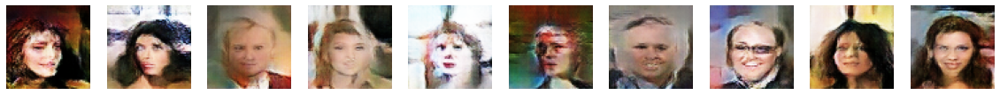

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 35: 144.49728406414283

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 65ms/step - c_acc: 47.0656 - c_gp: 0.0377 - c_loss: -5.0922 - c_wass_loss: -5.4696 - g_acc: 53.9594 - g_loss: 16.9580 - fid: 144.4973
Epoch 36/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 57.0281 - c_gp: 0.0409 - c_loss: -4.2279 - c_wass_loss: -4.6367 - g_acc: 45.8469 - g_loss: -19.5879
Saved to ./output/generated_img_035.png


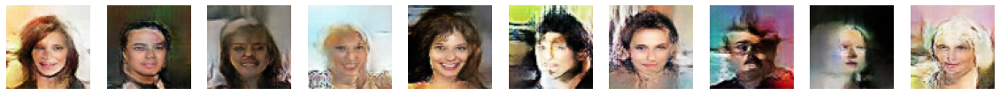

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 36: 161.8360652685938

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 57.0281 - c_gp: 0.0409 - c_loss: -4.2288 - c_wass_loss: -4.6376 - g_acc: 45.8469 - g_loss: -19.5623 - fid: 161.8361
Epoch 37/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 75.3063 - c_gp: 0.0332 - c_loss: -4.3444 - c_wass_loss: -4.6766 - g_acc: 26.0562 - g_loss: -54.2779
Saved to ./output/generated_img_036.png


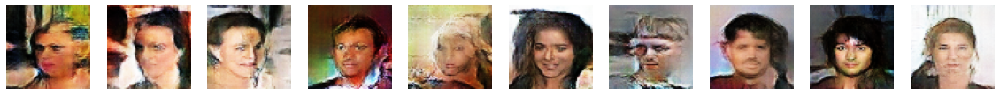

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 37: 167.09407249645784

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 69ms/step - c_acc: 75.3063 - c_gp: 0.0332 - c_loss: -4.3431 - c_wass_loss: -4.6753 - g_acc: 26.0562 - g_loss: -54.2798 - fid: 167.0941
Epoch 38/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 37.1052 - c_gp: 0.0381 - c_loss: -3.7264 - c_wass_loss: -4.1078 - g_acc: 64.5374 - g_loss: 45.9500
Saved to ./output/generated_img_037.png


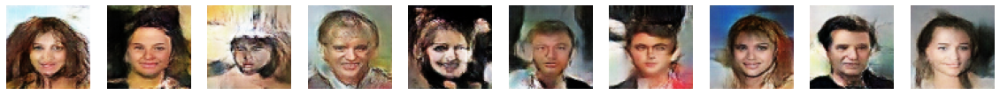

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 38: 145.89641768088146

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 65ms/step - c_acc: 37.1052 - c_gp: 0.0381 - c_loss: -3.7273 - c_wass_loss: -4.1087 - g_acc: 64.5374 - g_loss: 45.9339 - fid: 145.8964
Epoch 39/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 52.3469 - c_gp: 0.0303 - c_loss: -4.1289 - c_wass_loss: -4.4316 - g_acc: 49.0500 - g_loss: 16.8505
Saved to ./output/generated_img_038.png


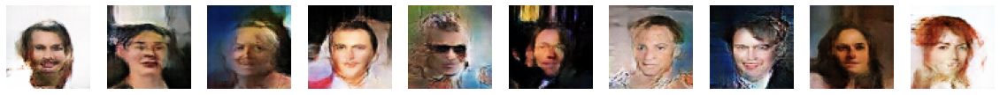

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 39: 153.17878660257463

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 52.3469 - c_gp: 0.0303 - c_loss: -4.1261 - c_wass_loss: -4.4289 - g_acc: 49.0500 - g_loss: 16.8163 - fid: 153.1788
Epoch 40/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 43.8375 - c_gp: 0.0340 - c_loss: -3.8111 - c_wass_loss: -4.1513 - g_acc: 58.2687 - g_loss: 1.3190
Saved to ./output/generated_img_039.png


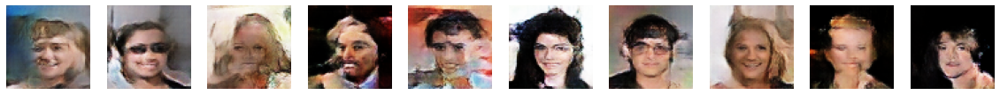

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 40: 149.3736377550473

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 70ms/step - c_acc: 43.8375 - c_gp: 0.0340 - c_loss: -3.8099 - c_wass_loss: -4.1502 - g_acc: 58.2687 - g_loss: 1.3526 - fid: 149.3736


In [18]:
loss_history = LossHistory()
FID_metric = FIDCallback(real_images=train_data, latent_dim=Z_DIM)

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), FID_metric, loss_history],
)

In [19]:
# Save the final models
generator.save("./models/generator_less_dp.keras")
critic.save("./models/critic_less_dp.keras")

## Generate images

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


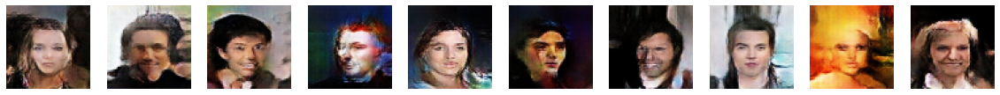

In [20]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)

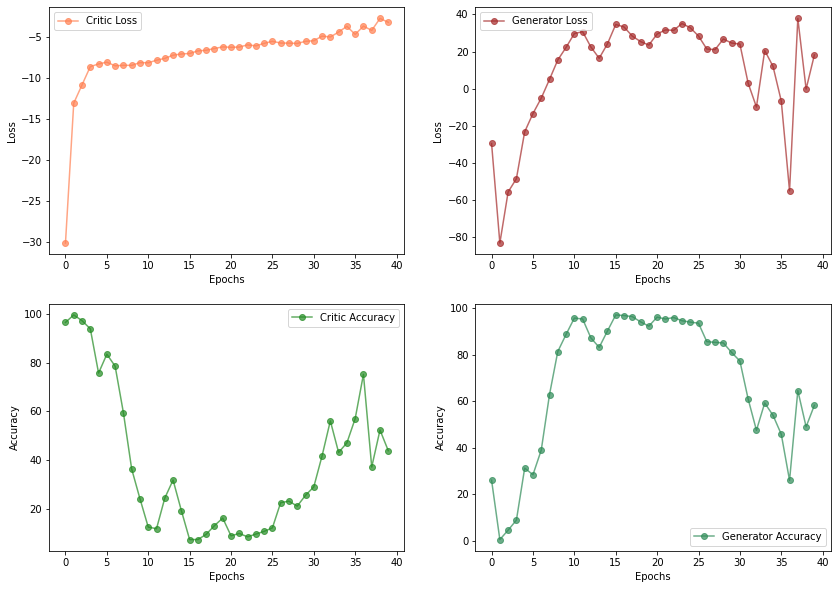

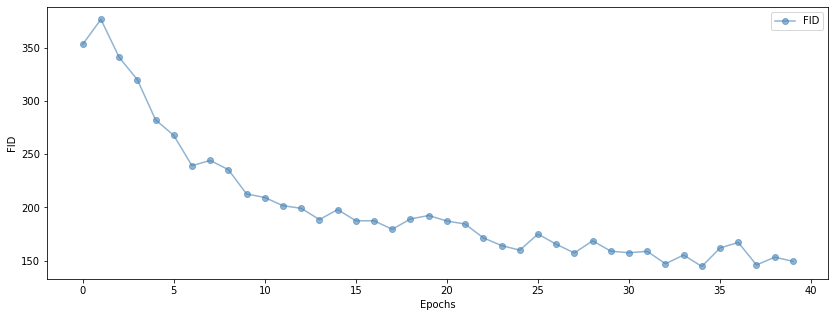

In [21]:
plot_losses_and_accuracy(loss_history)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results discussion**

After creating a new Critic that uses less Dropout and retraining the WGAN-GP, it can be observed that the results obtained are slightly better. Quantitatively, the FID improves more compared to the previous results, achieving a value of **149.373**. Additionally, greater **stability** in training is observed, with fewer oscillations. Moreover, upon observing the images generated during and after the training, it can be seen that the quality of the images has slightly improved. Although there are still artifacts and clear issues, their severity has been slightly reduced. This is a subjective metric, but it aligns with the observed quantitative results.

Notably, at the end of the training, there appears to be a spike in the Critic's accuracy and a drop in the Generator's accuracy. This could be due to a too high learning rate in the final stages of training, causing the Generator to **overshoot** a minimum without reaching it. Therefore, we propose using a **learning rate scheduler** to adjust and reduce the learning rate during training, achieving finer optimization in the final stages.


</div>

## **Using a Learning Rate Scheduler**

In [18]:
wgangp = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

In [19]:
# Optimizer con learning rate decay
LEARNING_RATE = 0.0002
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    LEARNING_RATE,
    decay_steps=1000,
    decay_rate=0.96,
    staircase=True)

# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(learning_rate=lr_schedule, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=lr_schedule, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

Epoch 1/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 97.0375 - c_gp: 1.5201 - c_loss: -39.4134 - c_wass_loss: -54.6146 - g_acc: 15.2750 - g_loss: -25.5439
Saved to ./output/generated_img_000.png


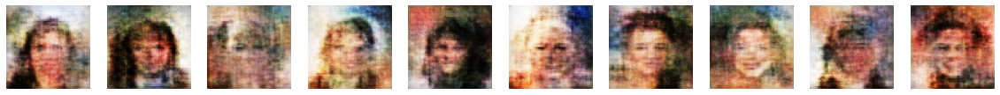

2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 16ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step 


FID at epoch 1: 358.6895470137654

500/500 ━━━━━━━━━━━━━━━━━━━━ 65s 90ms/step - c_acc: 97.0375 - c_gp: 1.5184 - c_loss: -39.3814 - c_wass_loss: -54.5658 - g_acc: 15.2750 - g_loss: -25.5875 - fid: 358.6895
Epoch 2/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 85.3875 - c_gp: 0.1949 - c_loss: -12.3314 - c_wass_loss: -14.2806 - g_acc: 22.3219 - g_loss: -38.2138
Saved to ./output/generated_img_001.png


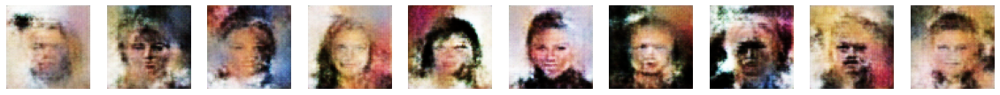

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 2: 315.32614335474284

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 85.3875 - c_gp: 0.1949 - c_loss: -12.3294 - c_wass_loss: -14.2781 - g_acc: 22.3219 - g_loss: -38.2001 - fid: 315.3261
Epoch 3/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 57.0125 - c_gp: 0.1414 - c_loss: -9.9294 - c_wass_loss: -11.3432 - g_acc: 58.6000 - g_loss: 0.7105
Saved to ./output/generated_img_002.png


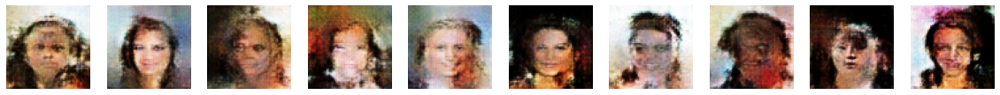

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 3: 286.87322879648355

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 57.0125 - c_gp: 0.1414 - c_loss: -9.9290 - c_wass_loss: -11.3428 - g_acc: 58.6000 - g_loss: 0.7206 - fid: 286.8732
Epoch 4/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 53.7844 - c_gp: 0.1334 - c_loss: -9.3433 - c_wass_loss: -10.6777 - g_acc: 61.5938 - g_loss: 4.0809
Saved to ./output/generated_img_003.png


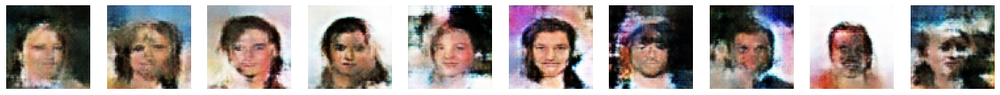

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 4: 265.05834289113034

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 53.7844 - c_gp: 0.1334 - c_loss: -9.3435 - c_wass_loss: -10.6777 - g_acc: 61.5938 - g_loss: 4.0906 - fid: 265.0583
Epoch 5/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 45.2906 - c_gp: 0.1138 - c_loss: -7.8771 - c_wass_loss: -9.0153 - g_acc: 59.2031 - g_loss: 25.3921
Saved to ./output/generated_img_004.png


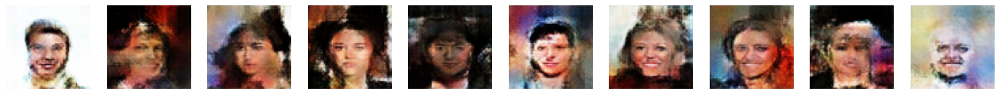

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 5: 228.48916097414624

500/500 ━━━━━━━━━━━━━━━━━━━━ 30s 61ms/step - c_acc: 45.2906 - c_gp: 0.1138 - c_loss: -7.8757 - c_wass_loss: -9.0137 - g_acc: 59.2031 - g_loss: 25.3707 - fid: 228.4892
Epoch 6/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 48.6625 - c_gp: 0.0927 - c_loss: -9.6740 - c_wass_loss: -10.6010 - g_acc: 59.0312 - g_loss: 19.8873
Saved to ./output/generated_img_005.png


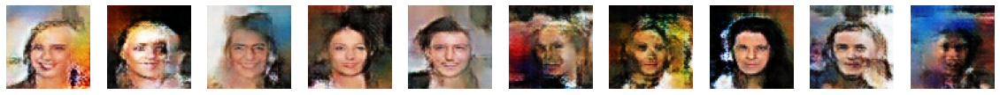

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 6: 226.03961932437386

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 48.6625 - c_gp: 0.0927 - c_loss: -9.6702 - c_wass_loss: -10.5972 - g_acc: 59.0312 - g_loss: 19.8707 - fid: 226.0396
Epoch 7/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - c_acc: 37.4885 - c_gp: 0.0860 - c_loss: -6.8957 - c_wass_loss: -7.7557 - g_acc: 72.0695 - g_loss: 10.2069
Saved to ./output/generated_img_006.png


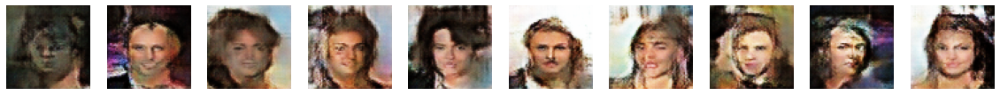

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 7: 216.60721817728927

500/500 ━━━━━━━━━━━━━━━━━━━━ 46s 92ms/step - c_acc: 37.4885 - c_gp: 0.0860 - c_loss: -6.8957 - c_wass_loss: -7.7556 - g_acc: 72.0695 - g_loss: 10.2225 - fid: 216.6072
Epoch 8/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 48.7469 - c_gp: 0.0737 - c_loss: -6.4081 - c_wass_loss: -7.1453 - g_acc: 60.0844 - g_loss: 8.5991
Saved to ./output/generated_img_007.png


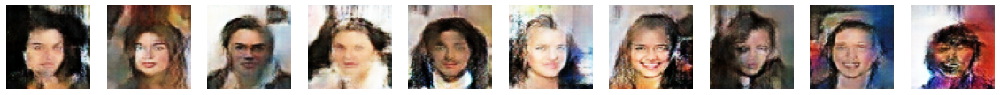

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 8: 213.6792087518752

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 48.7469 - c_gp: 0.0737 - c_loss: -6.4081 - c_wass_loss: -7.1452 - g_acc: 60.0844 - g_loss: 8.5992 - fid: 213.6792
Epoch 9/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 32.0969 - c_gp: 0.0636 - c_loss: -6.6442 - c_wass_loss: -7.2804 - g_acc: 75.5000 - g_loss: 18.9785
Saved to ./output/generated_img_008.png


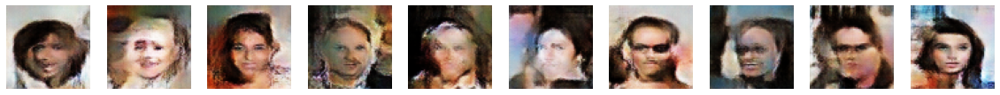

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 9: 190.72603109889974

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 62ms/step - c_acc: 32.0969 - c_gp: 0.0636 - c_loss: -6.6438 - c_wass_loss: -7.2800 - g_acc: 75.5000 - g_loss: 18.9831 - fid: 190.7260
Epoch 10/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 35.5125 - c_gp: 0.0630 - c_loss: -5.9810 - c_wass_loss: -6.6114 - g_acc: 72.6687 - g_loss: 19.7395
Saved to ./output/generated_img_009.png


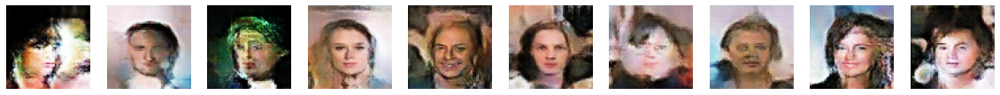

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 10: 194.69026117419602

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 35.5125 - c_gp: 0.0630 - c_loss: -5.9807 - c_wass_loss: -6.6112 - g_acc: 72.6687 - g_loss: 19.7346 - fid: 194.6903
Epoch 11/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - c_acc: 45.1937 - c_gp: 0.0520 - c_loss: -5.0347 - c_wass_loss: -5.5547 - g_acc: 64.3781 - g_loss: 9.7550
Saved to ./output/generated_img_010.png


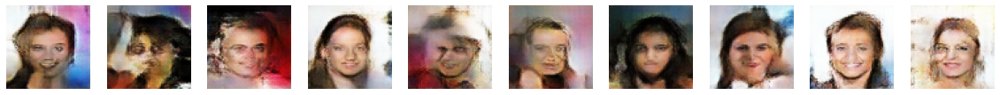

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 11: 195.39699916512018

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 61ms/step - c_acc: 45.1937 - c_gp: 0.0520 - c_loss: -5.0353 - c_wass_loss: -5.5553 - g_acc: 64.3781 - g_loss: 9.7534 - fid: 195.3970
Epoch 12/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 34.9969 - c_gp: 0.0487 - c_loss: -5.8327 - c_wass_loss: -6.3195 - g_acc: 75.6781 - g_loss: 16.5439
Saved to ./output/generated_img_011.png


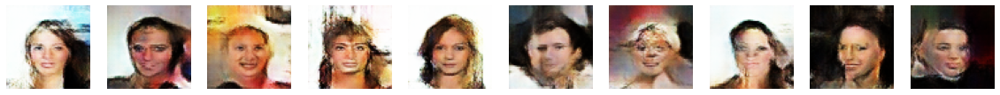

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 12: 168.47517786332764

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 34.9969 - c_gp: 0.0487 - c_loss: -5.8319 - c_wass_loss: -6.3187 - g_acc: 75.6781 - g_loss: 16.5379 - fid: 168.4752
Epoch 13/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 27.7290 - c_gp: 0.0472 - c_loss: -4.9202 - c_wass_loss: -5.3919 - g_acc: 81.9699 - g_loss: 16.1234
Saved to ./output/generated_img_012.png


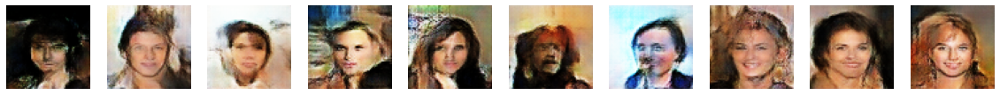

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 13: 195.91872710381378

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 63ms/step - c_acc: 27.7290 - c_gp: 0.0472 - c_loss: -4.9202 - c_wass_loss: -5.3918 - g_acc: 81.9699 - g_loss: 16.1218 - fid: 195.9187
Epoch 14/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 29.8281 - c_gp: 0.0427 - c_loss: -4.8378 - c_wass_loss: -5.2652 - g_acc: 81.3688 - g_loss: 11.0907
Saved to ./output/generated_img_013.png


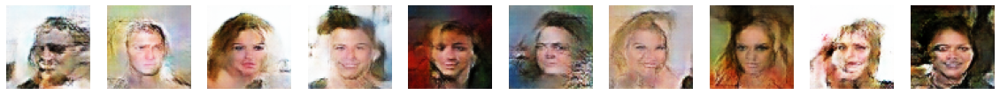

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 14: 182.97736318361848

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 63ms/step - c_acc: 29.8281 - c_gp: 0.0427 - c_loss: -4.8378 - c_wass_loss: -5.2652 - g_acc: 81.3688 - g_loss: 11.0959 - fid: 182.9774
Epoch 15/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 24.3031 - c_gp: 0.0418 - c_loss: -4.5529 - c_wass_loss: -4.9706 - g_acc: 83.5719 - g_loss: 17.4555
Saved to ./output/generated_img_014.png


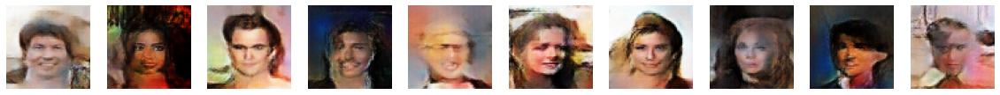

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 15: 171.36452947238237

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 63ms/step - c_acc: 24.3031 - c_gp: 0.0418 - c_loss: -4.5529 - c_wass_loss: -4.9706 - g_acc: 83.5719 - g_loss: 17.4545 - fid: 171.3645
Epoch 16/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 23.1562 - c_gp: 0.0378 - c_loss: -4.0646 - c_wass_loss: -4.4422 - g_acc: 84.9906 - g_loss: 15.1121
Saved to ./output/generated_img_015.png


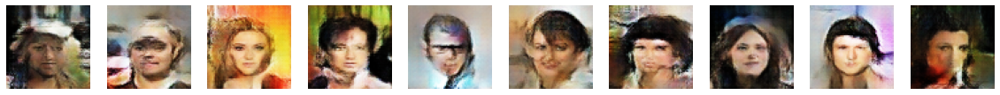

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 16: 177.53039772162555

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 23.1562 - c_gp: 0.0378 - c_loss: -4.0648 - c_wass_loss: -4.4423 - g_acc: 84.9906 - g_loss: 15.1131 - fid: 177.5304
Epoch 17/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 17.5125 - c_gp: 0.0347 - c_loss: -4.0303 - c_wass_loss: -4.3773 - g_acc: 89.3812 - g_loss: 18.1079
Saved to ./output/generated_img_016.png


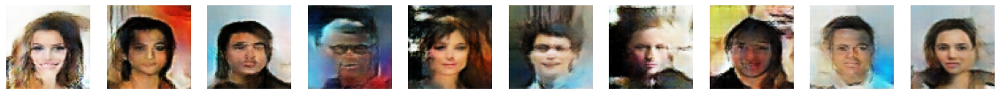

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 17: 169.941312974547

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 17.5125 - c_gp: 0.0347 - c_loss: -4.0301 - c_wass_loss: -4.3771 - g_acc: 89.3812 - g_loss: 18.1077 - fid: 169.9413
Epoch 18/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 18.4969 - c_gp: 0.0321 - c_loss: -3.8739 - c_wass_loss: -4.1949 - g_acc: 89.1562 - g_loss: 15.1399
Saved to ./output/generated_img_017.png


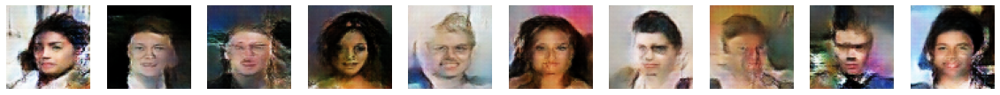

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 18: 165.2108427482816

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 63ms/step - c_acc: 18.4969 - c_gp: 0.0321 - c_loss: -3.8739 - c_wass_loss: -4.1948 - g_acc: 89.1562 - g_loss: 15.1425 - fid: 165.2108
Epoch 19/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 12.5208 - c_gp: 0.0288 - c_loss: -3.5696 - c_wass_loss: -3.8579 - g_acc: 92.6554 - g_loss: 18.9747
Saved to ./output/generated_img_018.png


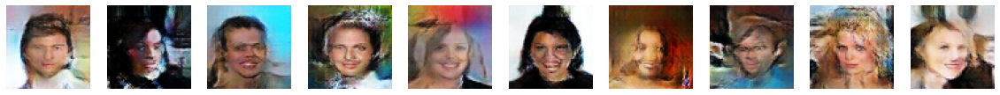

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 19: 170.11525408553908

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 12.5208 - c_gp: 0.0288 - c_loss: -3.5696 - c_wass_loss: -3.8579 - g_acc: 92.6554 - g_loss: 18.9755 - fid: 170.1153
Epoch 20/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 12.7125 - c_gp: 0.0273 - c_loss: -3.4003 - c_wass_loss: -3.6733 - g_acc: 92.4125 - g_loss: 18.5528
Saved to ./output/generated_img_019.png


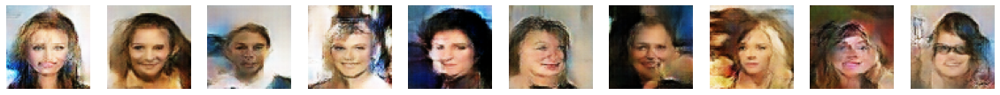

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 20: 171.67803993525195

500/500 ━━━━━━━━━━━━━━━━━━━━ 31s 63ms/step - c_acc: 12.7125 - c_gp: 0.0273 - c_loss: -3.4002 - c_wass_loss: -3.6732 - g_acc: 92.4125 - g_loss: 18.5516 - fid: 171.6780
Epoch 21/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 11.5063 - c_gp: 0.0256 - c_loss: -3.0562 - c_wass_loss: -3.3122 - g_acc: 93.1125 - g_loss: 18.1181
Saved to ./output/generated_img_020.png


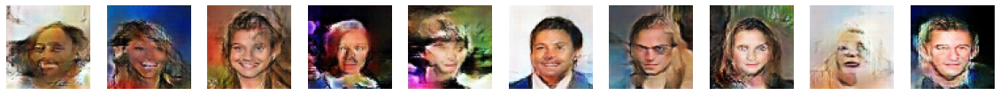

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 21: 151.19202341458413

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 11.5063 - c_gp: 0.0256 - c_loss: -3.0564 - c_wass_loss: -3.3123 - g_acc: 93.1125 - g_loss: 18.1181 - fid: 151.1920
Epoch 22/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 12.8594 - c_gp: 0.0229 - c_loss: -3.3207 - c_wass_loss: -3.5494 - g_acc: 91.9156 - g_loss: 17.9044
Saved to ./output/generated_img_021.png


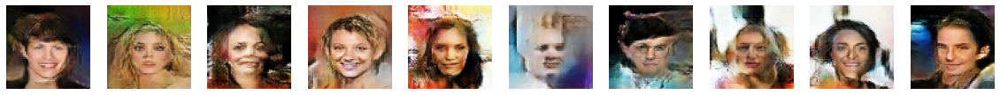

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


FID at epoch 22: 152.3073745045923

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 63ms/step - c_acc: 12.8594 - c_gp: 0.0229 - c_loss: -3.3202 - c_wass_loss: -3.5489 - g_acc: 91.9156 - g_loss: 17.9033 - fid: 152.3074
Epoch 23/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 14.3062 - c_gp: 0.0213 - c_loss: -2.8194 - c_wass_loss: -3.0323 - g_acc: 91.0938 - g_loss: 15.1486
Saved to ./output/generated_img_022.png


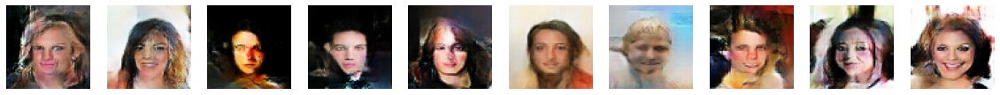

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 23: 156.66196503907508

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 63ms/step - c_acc: 14.3062 - c_gp: 0.0213 - c_loss: -2.8192 - c_wass_loss: -3.0321 - g_acc: 91.0938 - g_loss: 15.1481 - fid: 156.6620
Epoch 24/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 14.1625 - c_gp: 0.0186 - c_loss: -2.5544 - c_wass_loss: -2.7403 - g_acc: 90.9000 - g_loss: 14.5736
Saved to ./output/generated_img_023.png


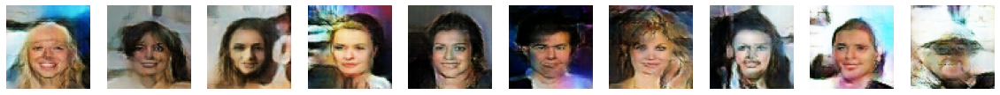

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 24: 151.2060768547044

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 67ms/step - c_acc: 14.1625 - c_gp: 0.0186 - c_loss: -2.5544 - c_wass_loss: -2.7403 - g_acc: 90.9000 - g_loss: 14.5738 - fid: 151.2061
Epoch 25/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 14.6313 - c_gp: 0.0179 - c_loss: -2.4823 - c_wass_loss: -2.6614 - g_acc: 89.9906 - g_loss: 14.5123
Saved to ./output/generated_img_024.png


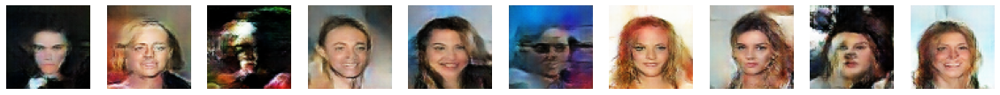

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 25: 146.1956234523979

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 14.6313 - c_gp: 0.0179 - c_loss: -2.4822 - c_wass_loss: -2.6612 - g_acc: 89.9906 - g_loss: 14.5128 - fid: 146.1956
Epoch 26/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 8.9694 - c_gp: 0.0154 - c_loss: -2.4633 - c_wass_loss: -2.6177 - g_acc: 94.3741 - g_loss: 18.2979
Saved to ./output/generated_img_025.png


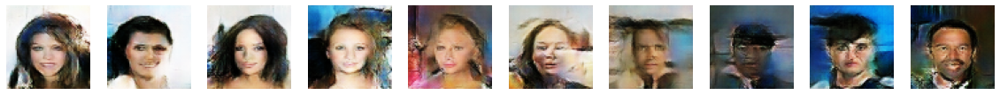

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 26: 142.5128576306133

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 72ms/step - c_acc: 8.9694 - c_gp: 0.0154 - c_loss: -2.4632 - c_wass_loss: -2.6176 - g_acc: 94.3741 - g_loss: 18.2970 - fid: 142.5129
Epoch 27/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 8.9906 - c_gp: 0.0138 - c_loss: -2.0196 - c_wass_loss: -2.1572 - g_acc: 93.8562 - g_loss: 17.3797
Saved to ./output/generated_img_026.png


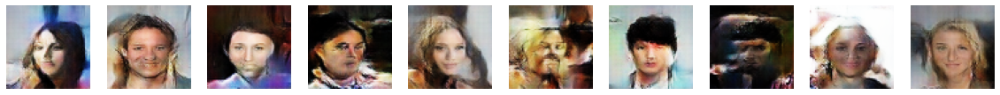

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 27: 145.29657761918514

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 63ms/step - c_acc: 8.9906 - c_gp: 0.0138 - c_loss: -2.0196 - c_wass_loss: -2.1572 - g_acc: 93.8562 - g_loss: 17.3803 - fid: 145.2966
Epoch 28/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 4.9062 - c_gp: 0.0129 - c_loss: -2.0714 - c_wass_loss: -2.2002 - g_acc: 96.5406 - g_loss: 21.8258
Saved to ./output/generated_img_027.png


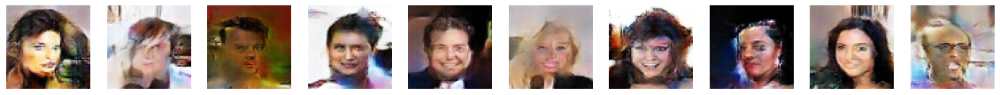

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 28: 147.36105019718278

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 4.9062 - c_gp: 0.0129 - c_loss: -2.0713 - c_wass_loss: -2.2000 - g_acc: 96.5406 - g_loss: 21.8266 - fid: 147.3611
Epoch 29/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 6.2781 - c_gp: 0.0112 - c_loss: -1.7975 - c_wass_loss: -1.9096 - g_acc: 95.8031 - g_loss: 19.4139
Saved to ./output/generated_img_028.png


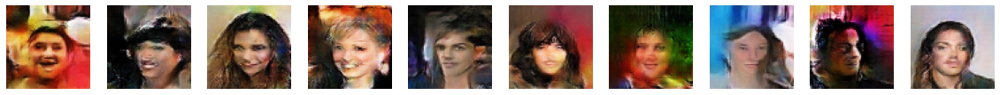

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 29: 137.5127501211091

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 6.2781 - c_gp: 0.0112 - c_loss: -1.7974 - c_wass_loss: -1.9095 - g_acc: 95.8031 - g_loss: 19.4146 - fid: 137.5128
Epoch 30/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 5.4656 - c_gp: 0.0098 - c_loss: -1.7688 - c_wass_loss: -1.8670 - g_acc: 96.2562 - g_loss: 20.8819
Saved to ./output/generated_img_029.png


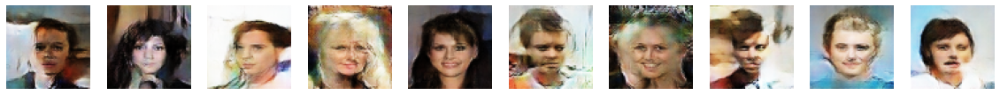

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 30: 130.36186248471506

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 67ms/step - c_acc: 5.4656 - c_gp: 0.0098 - c_loss: -1.7688 - c_wass_loss: -1.8669 - g_acc: 96.2562 - g_loss: 20.8813 - fid: 130.3619
Epoch 31/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 5.0250 - c_gp: 0.0094 - c_loss: -1.0873 - c_wass_loss: -1.1811 - g_acc: 96.2219 - g_loss: 20.8108
Saved to ./output/generated_img_030.png


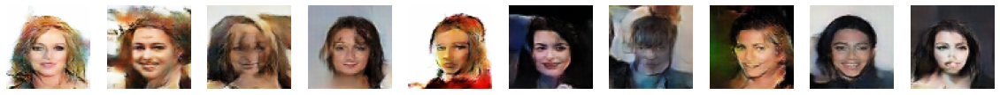

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 31: 129.8415724815762

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 5.0250 - c_gp: 0.0094 - c_loss: -1.0875 - c_wass_loss: -1.1813 - g_acc: 96.2219 - g_loss: 20.8088 - fid: 129.8416
Epoch 32/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 5.0518 - c_gp: 0.0083 - c_loss: -1.1932 - c_wass_loss: -1.2761 - g_acc: 96.2750 - g_loss: 18.5993
Saved to ./output/generated_img_031.png


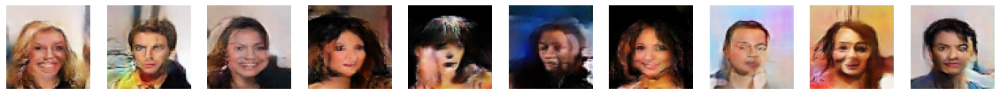

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 32: 142.9103907211382

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 5.0518 - c_gp: 0.0083 - c_loss: -1.1932 - c_wass_loss: -1.2761 - g_acc: 96.2750 - g_loss: 18.6007 - fid: 142.9104
Epoch 33/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 4.5594 - c_gp: 0.0072 - c_loss: -1.1604 - c_wass_loss: -1.2328 - g_acc: 96.3875 - g_loss: 19.2148
Saved to ./output/generated_img_032.png


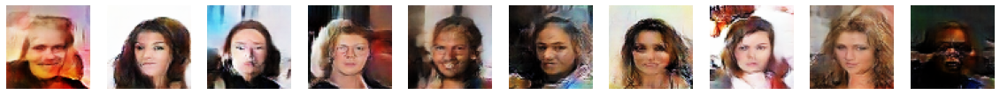

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 33: 137.37612498649432

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 70ms/step - c_acc: 4.5594 - c_gp: 0.0072 - c_loss: -1.1603 - c_wass_loss: -1.2328 - g_acc: 96.3875 - g_loss: 19.2149 - fid: 137.3761
Epoch 34/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 3.8375 - c_gp: 0.0068 - c_loss: -1.2282 - c_wass_loss: -1.2961 - g_acc: 96.8656 - g_loss: 20.4012
Saved to ./output/generated_img_033.png


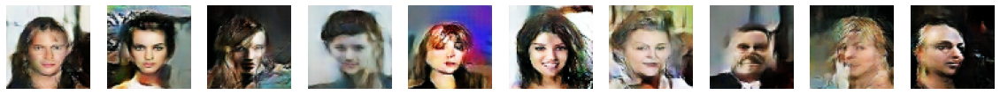

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 34: 136.5919515592742

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 3.8375 - c_gp: 0.0068 - c_loss: -1.2278 - c_wass_loss: -1.2957 - g_acc: 96.8656 - g_loss: 20.4014 - fid: 136.5920
Epoch 35/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 3.8750 - c_gp: 0.0064 - c_loss: -0.9614 - c_wass_loss: -1.0257 - g_acc: 96.8094 - g_loss: 19.4785
Saved to ./output/generated_img_034.png


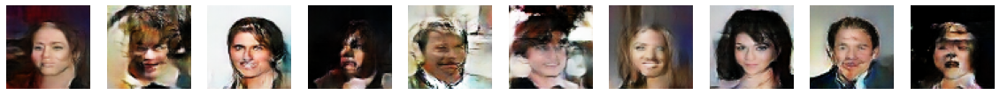

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 35: 130.8730983449095

500/500 ━━━━━━━━━━━━━━━━━━━━ 32s 64ms/step - c_acc: 3.8750 - c_gp: 0.0064 - c_loss: -0.9614 - c_wass_loss: -1.0257 - g_acc: 96.8094 - g_loss: 19.4784 - fid: 130.8731
Epoch 36/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - c_acc: 3.2812 - c_gp: 0.0057 - c_loss: -1.0260 - c_wass_loss: -1.0832 - g_acc: 97.3875 - g_loss: 20.5673
Saved to ./output/generated_img_035.png


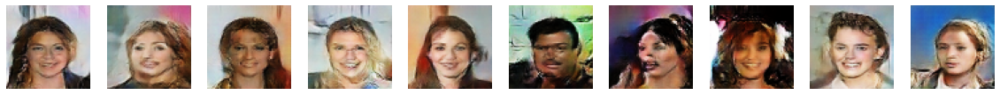

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 36: 132.7734927662026

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 65ms/step - c_acc: 3.2812 - c_gp: 0.0057 - c_loss: -1.0257 - c_wass_loss: -1.0828 - g_acc: 97.3875 - g_loss: 20.5682 - fid: 132.7735
Epoch 37/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 3.4188 - c_gp: 0.0052 - c_loss: -0.5792 - c_wass_loss: -0.6316 - g_acc: 97.0938 - g_loss: 20.3984
Saved to ./output/generated_img_036.png


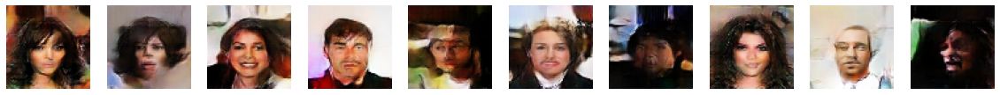

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 37: 137.40423296083105

500/500 ━━━━━━━━━━━━━━━━━━━━ 34s 68ms/step - c_acc: 3.4188 - c_gp: 0.0052 - c_loss: -0.5794 - c_wass_loss: -0.6318 - g_acc: 97.0938 - g_loss: 20.3989 - fid: 137.4042
Epoch 38/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 3.1333 - c_gp: 0.0049 - c_loss: -0.7040 - c_wass_loss: -0.7531 - g_acc: 97.4719 - g_loss: 20.6398
Saved to ./output/generated_img_037.png


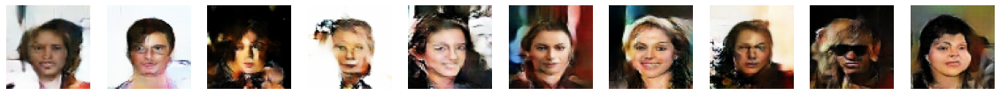

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


FID at epoch 38: 124.0549431284445

500/500 ━━━━━━━━━━━━━━━━━━━━ 35s 70ms/step - c_acc: 3.1333 - c_gp: 0.0049 - c_loss: -0.7039 - c_wass_loss: -0.7530 - g_acc: 97.4719 - g_loss: 20.6398 - fid: 124.0549
Epoch 39/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 2.6656 - c_gp: 0.0044 - c_loss: -0.7276 - c_wass_loss: -0.7717 - g_acc: 97.5281 - g_loss: 20.5463
Saved to ./output/generated_img_038.png


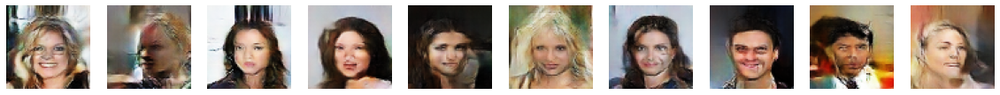

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 39: 135.3870000453926

500/500 ━━━━━━━━━━━━━━━━━━━━ 36s 72ms/step - c_acc: 2.6656 - c_gp: 0.0044 - c_loss: -0.7273 - c_wass_loss: -0.7714 - g_acc: 97.5281 - g_loss: 20.5465 - fid: 135.3870
Epoch 40/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - c_acc: 2.0719 - c_gp: 0.0042 - c_loss: -0.5278 - c_wass_loss: -0.5696 - g_acc: 98.2969 - g_loss: 21.1262
Saved to ./output/generated_img_039.png


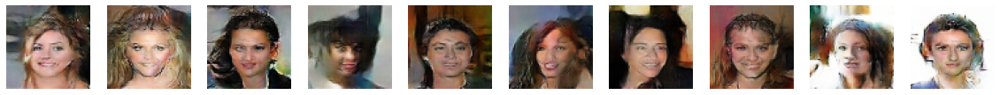

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 40: 139.03113077597118

500/500 ━━━━━━━━━━━━━━━━━━━━ 33s 66ms/step - c_acc: 2.0719 - c_gp: 0.0042 - c_loss: -0.5277 - c_wass_loss: -0.5696 - g_acc: 98.2969 - g_loss: 21.1271 - fid: 139.0311


In [20]:
loss_history = LossHistory()
FID_metric = FIDCallback(real_images=train_data, latent_dim=Z_DIM)

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), FID_metric, loss_history],
)

### **Generating some images**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


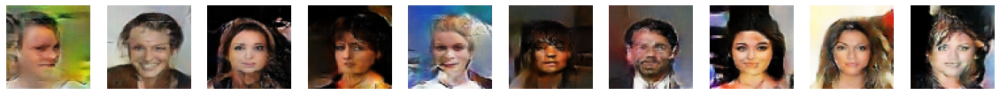

In [23]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)

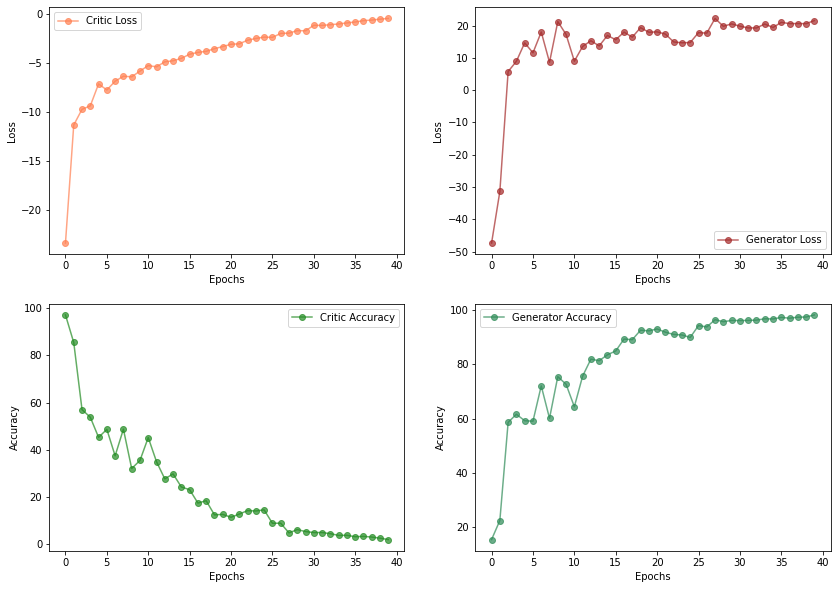

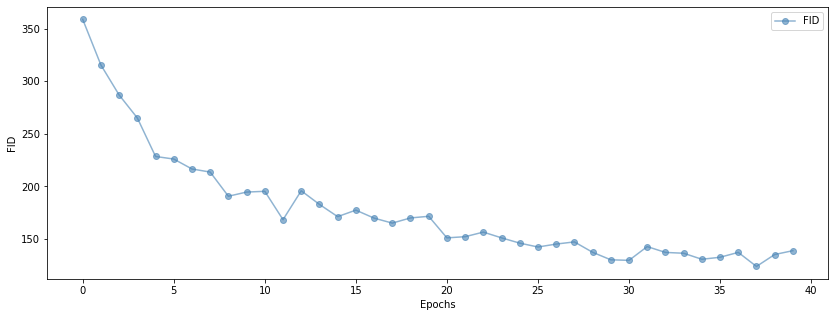

In [81]:
plot_losses_and_accuracy(loss_history)

In [82]:
# Save the final models
generator.save("./models/generator_lrS.keras")
critic.save("./models/critic_lrS.keras")

<div style="background-color: #ffffcc; padding: 10px;">

### **Results discussion**

After using the learning rate scheduler, the issue of the spike at the end of the training has been **solved**, resulting in a **more stable** training process. Additionally, the achieved **FID is the best** so far: **139.031**. Qualitatively, the generated images appear to be of **slightly higher quality** than in previous cases. However, they **still** present **significant issues** recurrently, struggling to generate realistic and detailed images.

One of our hypotheses is that the use of larger kernels in the generator (4×4) might hinder the generation of finer details. Therefore, we decided to test a subsequent model using a generator architecture that employs 3×3 kernels.

</div>

## **Using a 3x3 kernel on generator**

In [26]:
def build_generator(z_dim, img_shape):
    generator_input = layers.Input(shape=(z_dim,))
    x = layers.Dense(4 * 4 * 1024, use_bias=False)(generator_input)
    x = layers.Reshape((4, 4, 1024))(x)
    x = layers.BatchNormalization(momentum=0.9)(x)
    x = layers.LeakyReLU(0.2)(x)

    # Upsampling layers with 3x3 Conv2D and stride 1
    x = layers.UpSampling2D()(x)
    x = layers.Conv2D(512, kernel_size=3, strides=1, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization(momentum=0.9)(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.UpSampling2D()(x)
    x = layers.Conv2D(256, kernel_size=3, strides=1, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization(momentum=0.9)(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.UpSampling2D()(x)
    x = layers.Conv2D(128, kernel_size=3, strides=1, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization(momentum=0.9)(x)
    x = layers.LeakyReLU(0.2)(x)

    x = layers.UpSampling2D()(x)
    x = layers.Conv2D(64, kernel_size=3, strides=1, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization(momentum=0.9)(x)
    x = layers.LeakyReLU(0.2)(x)

    generator_output = layers.Conv2D(img_shape[-1], kernel_size=3, strides=1, padding="same", activation="tanh")(x)

    generator = models.Model(generator_input, generator_output)
    return generator

In [27]:
generator = build_generator(Z_DIM, (IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
generator.summary()

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape              ┃    Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 128)               │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ dense_3 (Dense)                 │ (None, 16384)             │  2,097,152 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ reshape_4 (Reshape)             │ (None, 4, 4, 1024)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_123         │ (None, 4, 4, 1024)        │      4,096 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_23 (LeakyReLU)      │ (None, 4, 4, 1024)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ up_sampling2d_12 (UpSampling2D) │ (None, 8, 8, 1024)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_124 (Conv2D)             │ (None, 8, 8, 512)         │  4,718,592 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_124         │ (None, 8, 8, 512)         │      2,048 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_24 (LeakyReLU)      │ (None, 8, 8, 512)         │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ up_sampling2d_13 (UpSampling2D) │ (None, 16, 16, 512)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_125 (Conv2D)             │ (None, 16, 16, 256)       │  1,179,648 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_125         │ (None, 16, 16, 256)       │      1,024 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_25 (LeakyReLU)      │ (None, 16, 16, 256)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ up_sampling2d_14 (UpSampling2D) │ (None, 32, 32, 256)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_126 (Conv2D)             │ (None, 32, 32, 128)       │    294,912 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_126         │ (None, 32, 32, 128)       │        512 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_26 (LeakyReLU)      │ (None, 32, 32, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ up_sampling2d_15 (UpSampling2D) │ (None, 64, 64, 128)       │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_127 (Conv2D)             │ (None, 64, 64, 64)        │     73,728 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ batch_normalization_127         │ (None, 64, 64, 64)        │        256 │
│ (BatchNormalization)            │                           │            │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ leaky_re_lu_27 (LeakyReLU)      │ (None, 64, 64, 64)        │          0 │
├─────────────────────────────────┼───────────────────────────┼────────────┤
│ conv2d_128 (Conv2D)             │ (None, 64, 64, 3)         │      1,731 │
└─────────────────────────────────┴───────────────────────────┴──────────

 Total params: 8,373,699 (31.94 MB)

 Trainable params: 8,369,731 (31.93 MB)

 Non-trainable params: 3,968 (15.50 KB)

In [28]:
wgangp = WGANGP(critic=critic, generator=generator, latent_dim=Z_DIM, critic_steps=CRITIC_STEPS, gp_weight=GP_WEIGHT)

In [29]:
# Optimizer con learning rate decay
LEARNING_RATE = 0.0002
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    LEARNING_RATE,
    decay_steps=1000,
    decay_rate=0.96,
    staircase=True)

# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(learning_rate=lr_schedule, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
    g_optimizer=optimizers.Adam(learning_rate=lr_schedule, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2),
)

Epoch 1/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 19.1656 - c_gp: 0.8049 - c_loss: -28.2261 - c_wass_loss: -36.2753 - g_acc: 81.3656 - g_loss: 433.7910
Saved to ./output/generated_img_000.png


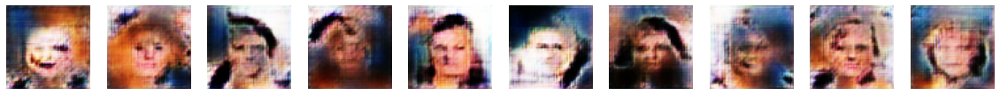

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 585ms/step


FID at epoch 1: 334.5278501139779

500/500 ━━━━━━━━━━━━━━━━━━━━ 77s 113ms/step - c_acc: 19.1656 - c_gp: 0.8041 - c_loss: -28.2234 - c_wass_loss: -36.2647 - g_acc: 81.3656 - g_loss: 433.6105 - fid: 334.5279
Epoch 2/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 46.3344 - c_gp: 0.3778 - c_loss: -5.0174 - c_wass_loss: -8.7959 - g_acc: 53.5563 - g_loss: 710.8560
Saved to ./output/generated_img_001.png


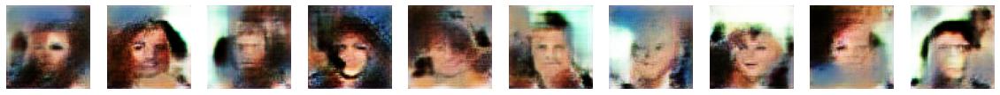

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 2: 317.5026888369385

500/500 ━━━━━━━━━━━━━━━━━━━━ 55s 110ms/step - c_acc: 46.3344 - c_gp: 0.3777 - c_loss: -5.0165 - c_wass_loss: -8.7932 - g_acc: 53.5563 - g_loss: 710.1335 - fid: 317.5027
Epoch 3/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - c_acc: 66.2531 - c_gp: 0.1829 - c_loss: -7.6742 - c_wass_loss: -9.5031 - g_acc: 34.2969 - g_loss: -266.2188
Saved to ./output/generated_img_002.png


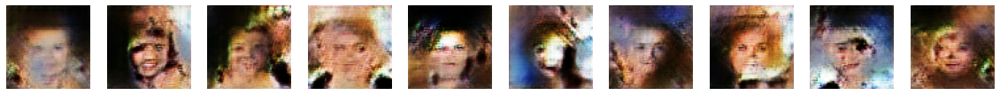

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 3: 330.9430996084287

500/500 ━━━━━━━━━━━━━━━━━━━━ 55s 111ms/step - c_acc: 66.2531 - c_gp: 0.1828 - c_loss: -7.6556 - c_wass_loss: -9.4838 - g_acc: 34.2969 - g_loss: -266.3770 - fid: 330.9431
Epoch 4/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 29.5156 - c_gp: 0.0807 - c_loss: -4.6083 - c_wass_loss: -5.4157 - g_acc: 73.1219 - g_loss: 93.2776
Saved to ./output/generated_img_003.png


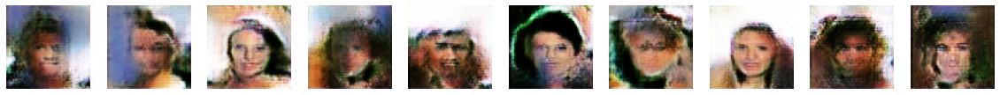

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 4: 310.4681942727907

500/500 ━━━━━━━━━━━━━━━━━━━━ 54s 109ms/step - c_acc: 29.5156 - c_gp: 0.0807 - c_loss: -4.6080 - c_wass_loss: -5.4154 - g_acc: 73.1219 - g_loss: 93.2698 - fid: 310.4682
Epoch 5/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 35.7313 - c_gp: 0.0684 - c_loss: -6.2440 - c_wass_loss: -6.9285 - g_acc: 67.3500 - g_loss: 20.4861
Saved to ./output/generated_img_004.png


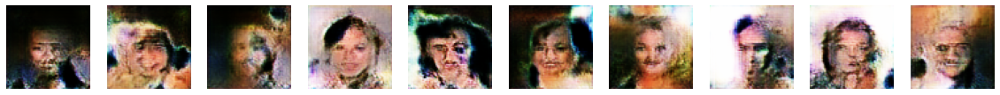

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 5: 318.0316860298242

500/500 ━━━━━━━━━━━━━━━━━━━━ 53s 106ms/step - c_acc: 35.7313 - c_gp: 0.0684 - c_loss: -6.2448 - c_wass_loss: -6.9292 - g_acc: 67.3500 - g_loss: 20.5168 - fid: 318.0317
Epoch 6/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 15.5875 - c_gp: 0.0734 - c_loss: -5.6512 - c_wass_loss: -6.3857 - g_acc: 87.0469 - g_loss: 71.4233
Saved to ./output/generated_img_005.png


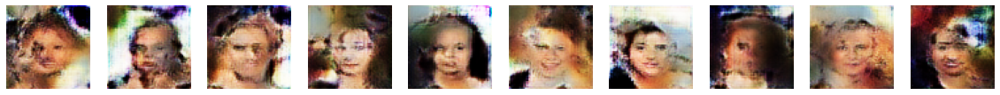

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 6: 266.3595595092636

500/500 ━━━━━━━━━━━━━━━━━━━━ 54s 109ms/step - c_acc: 15.5875 - c_gp: 0.0735 - c_loss: -5.6525 - c_wass_loss: -6.3871 - g_acc: 87.0469 - g_loss: 71.4438 - fid: 266.3596
Epoch 7/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - c_acc: 32.6000 - c_gp: 0.0808 - c_loss: -6.7882 - c_wass_loss: -7.5963 - g_acc: 69.9824 - g_loss: 96.1570
Saved to ./output/generated_img_006.png


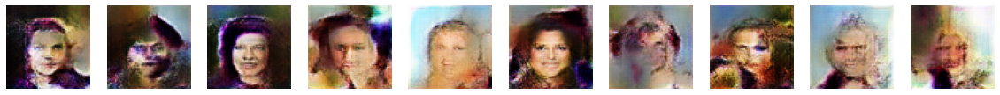

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 7: 244.6255986638118

500/500 ━━━━━━━━━━━━━━━━━━━━ 68s 135ms/step - c_acc: 32.6000 - c_gp: 0.0808 - c_loss: -6.7876 - c_wass_loss: -7.5955 - g_acc: 69.9824 - g_loss: 96.0687 - fid: 244.6256
Epoch 8/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - c_acc: 74.3469 - c_gp: 0.0785 - c_loss: -5.2679 - c_wass_loss: -6.0530 - g_acc: 27.9438 - g_loss: -104.9240
Saved to ./output/generated_img_007.png


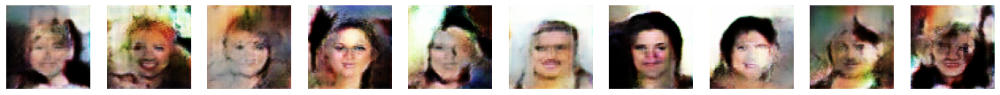

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 8: 239.6658152106016

500/500 ━━━━━━━━━━━━━━━━━━━━ 54s 107ms/step - c_acc: 74.3469 - c_gp: 0.0785 - c_loss: -5.2678 - c_wass_loss: -6.0529 - g_acc: 27.9438 - g_loss: -104.8889 - fid: 239.6658
Epoch 9/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 12.4312 - c_gp: 0.0555 - c_loss: -5.1233 - c_wass_loss: -5.6783 - g_acc: 88.2094 - g_loss: 248.9530
Saved to ./output/generated_img_008.png


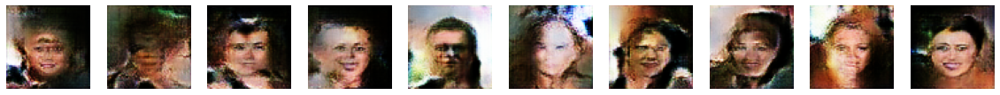

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 9: 258.9557899457754

500/500 ━━━━━━━━━━━━━━━━━━━━ 55s 110ms/step - c_acc: 12.4312 - c_gp: 0.0555 - c_loss: -5.1245 - c_wass_loss: -5.6796 - g_acc: 88.2094 - g_loss: 248.9492 - fid: 258.9558
Epoch 10/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 3.6094 - c_gp: 0.0687 - c_loss: -5.6226 - c_wass_loss: -6.3098 - g_acc: 96.9000 - g_loss: 192.4770
Saved to ./output/generated_img_009.png


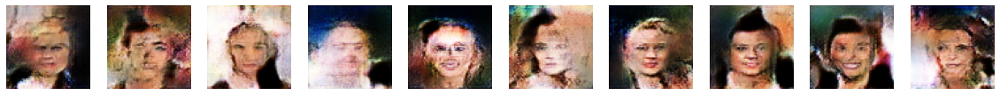

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 10: 263.97016679791517

500/500 ━━━━━━━━━━━━━━━━━━━━ 54s 107ms/step - c_acc: 3.6094 - c_gp: 0.0687 - c_loss: -5.6214 - c_wass_loss: -6.3085 - g_acc: 96.9000 - g_loss: 192.5251 - fid: 263.9702
Epoch 11/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 9.8344 - c_gp: 0.0708 - c_loss: -6.5944 - c_wass_loss: -7.3021 - g_acc: 90.5938 - g_loss: 289.2645
Saved to ./output/generated_img_010.png


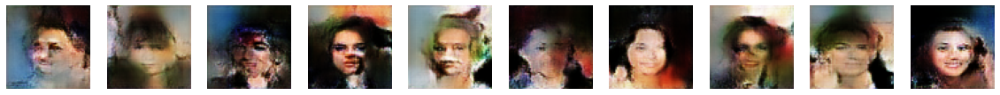

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 11: 233.80689717309124

500/500 ━━━━━━━━━━━━━━━━━━━━ 53s 107ms/step - c_acc: 9.8344 - c_gp: 0.0708 - c_loss: -6.5950 - c_wass_loss: -7.3026 - g_acc: 90.5938 - g_loss: 289.4246 - fid: 233.8069
Epoch 12/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - c_acc: 3.7313 - c_gp: 0.0740 - c_loss: -3.2882 - c_wass_loss: -4.0284 - g_acc: 96.3531 - g_loss: 483.2304
Saved to ./output/generated_img_011.png


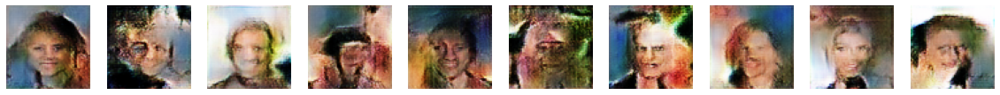

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 12: 256.57759402908715

500/500 ━━━━━━━━━━━━━━━━━━━━ 53s 106ms/step - c_acc: 3.7313 - c_gp: 0.0740 - c_loss: -3.2881 - c_wass_loss: -4.0284 - g_acc: 96.3531 - g_loss: 483.2975 - fid: 256.5776
Epoch 13/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 38.9058 - c_gp: 0.0533 - c_loss: -5.6084 - c_wass_loss: -6.1416 - g_acc: 62.8275 - g_loss: 336.2018
Saved to ./output/generated_img_012.png


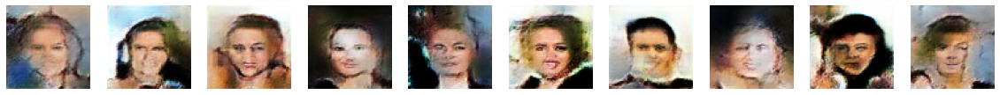

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 13: 245.56020317532523

500/500 ━━━━━━━━━━━━━━━━━━━━ 56s 112ms/step - c_acc: 38.9058 - c_gp: 0.0533 - c_loss: -5.6063 - c_wass_loss: -6.1394 - g_acc: 62.8275 - g_loss: 335.7746 - fid: 245.5602
Epoch 14/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 96.7688 - c_gp: 0.0608 - c_loss: -2.6788 - c_wass_loss: -3.2864 - g_acc: 3.2125 - g_loss: -148.9802
Saved to ./output/generated_img_013.png


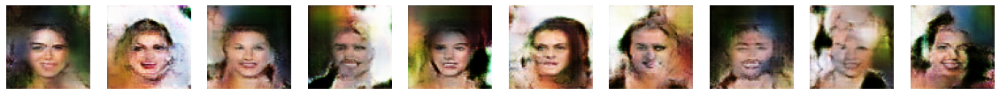

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 14: 230.0879974707641

500/500 ━━━━━━━━━━━━━━━━━━━━ 57s 114ms/step - c_acc: 96.7688 - c_gp: 0.0608 - c_loss: -2.6798 - c_wass_loss: -3.2874 - g_acc: 3.2125 - g_loss: -149.1897 - fid: 230.0880
Epoch 15/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 65.6500 - c_gp: 0.0684 - c_loss: 1.9059 - c_wass_loss: 1.2222 - g_acc: 34.6688 - g_loss: -528.3837
Saved to ./output/generated_img_014.png


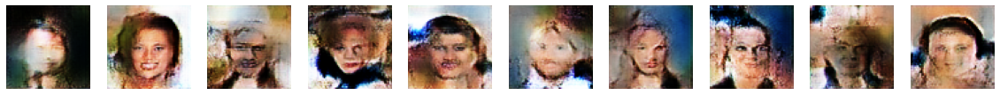

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 15: 251.2053487226549

500/500 ━━━━━━━━━━━━━━━━━━━━ 55s 111ms/step - c_acc: 65.6500 - c_gp: 0.0684 - c_loss: 1.9042 - c_wass_loss: 1.2205 - g_acc: 34.6688 - g_loss: -527.9103 - fid: 251.2053
Epoch 16/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - c_acc: 5.0219 - c_gp: 0.0857 - c_loss: 2.0123 - c_wass_loss: 1.1554 - g_acc: 95.2656 - g_loss: 572.0275
Saved to ./output/generated_img_015.png


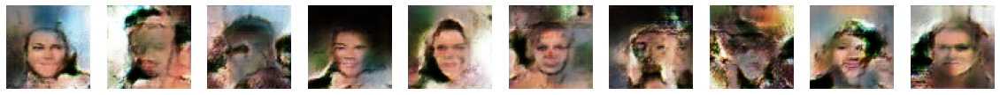

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


FID at epoch 16: 261.40489949338655

500/500 ━━━━━━━━━━━━━━━━━━━━ 54s 107ms/step - c_acc: 5.0219 - c_gp: 0.0857 - c_loss: 2.0089 - c_wass_loss: 1.1521 - g_acc: 95.2656 - g_loss: 572.0107 - fid: 261.4049
Epoch 17/40
500/500 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - c_acc: 24.7375 - c_gp: 0.0526 - c_loss: -1.2427 - c_wass_loss: -1.7688 - g_acc: 75.9594 - g_loss: 129.9195
Saved to ./output/generated_img_016.png


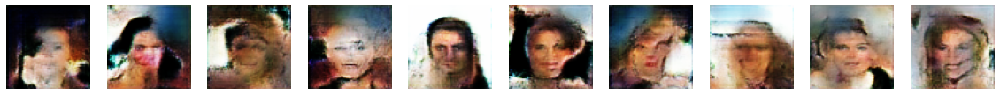

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


FID at epoch 17: 273.4923823694647

500/500 ━━━━━━━━━━━━━━━━━━━━ 55s 111ms/step - c_acc: 24.7375 - c_gp: 0.0526 - c_loss: -1.2429 - c_wass_loss: -1.7691 - g_acc: 75.9594 - g_loss: 129.9326 - fid: 273.4924
Epoch 18/40
146/500 ━━━━━━━━━━━━━━━━━━━━ 34s 99ms/step - c_acc: 86.4298 - c_gp: 0.0578 - c_loss: -2.8298 - c_wass_loss: -3.4074 - g_acc: 14.5655 - g_loss: -190.2658

KeyboardInterrupt: 

In [30]:
loss_history = LossHistory()
FID_metric = FIDCallback(real_images=train_data, latent_dim=Z_DIM)

wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[model_checkpoint_callback, tensorboard_callback, ImageGenerator(num_img=10, latent_dim=Z_DIM), FID_metric, loss_history],
)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results discussion**

After several epochs using the generator with **3×3** kernels, we decided to **stop the training**. Despite multiple attempts, we consistently stopped the training as **no noticeable improvement** was observed. The quality of the images seemed to have **deteriorated**, and the FID observed during the training was **worse** than that obtained with previous models at similar stages. Therefore, we concluded that it was not worth continuing the training of this model.

The inferior performance observed could be due to the **4×4** kernels having a **larger receptive field**, allowing the Generator to be more efficient and deeper, with fewer layers needed to **cover the same area**.

</div> 

## **Latent Space and Interpolation**

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

In [20]:
def interpolate_and_generate_images(generator, n_points):
    """
    Generate images by interpolating between two random points in the latent space.

    Parameters:
    n_points (int): Number of interpolation points.

    Returns:
    None
    """
    # Generate two random points in the latent space
    z1 = np.random.normal(size=(1, Z_DIM))
    z2 = np.random.normal(size=(1, Z_DIM))

    # Generate n_points interpolation vectors
    interpolation_vectors = np.linspace(0, 1, n_points).reshape(-1, 1)
    interpolated_z = z1 * (1 - interpolation_vectors) + z2 * interpolation_vectors

    # Generate images from the interpolated vectors
    interpolated_z = interpolated_z.reshape(n_points, Z_DIM)
    generated_images = generator.predict(interpolated_z)

    # Normalize images to [0, 1] range
    generated_images = (generated_images + 1) / 2.0

    # Plot all images in a single row
    plt.figure(figsize=(20, 2))
    for i in range(n_points):
        plt.subplot(1, n_points, i + 1)
        plt.imshow(generated_images[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()



In [18]:
# Load the trained generator model
generator = load_model("./models/generator_lrS.keras")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


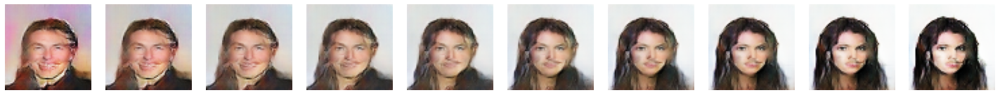

In [125]:
interpolate_and_generate_images(generator, 10)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


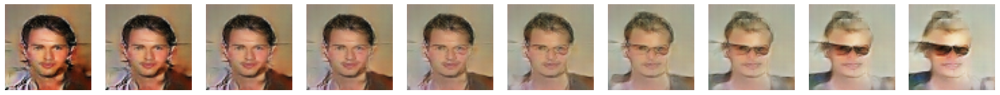

In [57]:
interpolate_and_generate_images(generator, 10)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results discussion**

Finally, to explore the latent space, in addition to the images generated with each model, an interpolation of latent vectors was performed. Random vectors were generated within the GAN's latent space and progressively interpolated to observe the effect on the images generated using the interpolated vectors. In the image above, it can be seen how the images transition smoothly from one to another, generating intermediate points that possess qualities of both extreme images. This highlights the qualities of GANs and their latent space, demonstrating their ability to capture and generate diverse variations. The interpolation process further showcases how subtle changes in the latent vectors can lead to significant and coherent changes in the generated images, emphasizing the model's capacity to learn and represent complex data distributions.

</div>

<div style="background-color: #ffffcc; padding: 10px;">

### **Future Work**

Although improvements have been achieved in the models, several problems persist, and the generated images are not sufficiently realistic. Some images are better and others acceptable, while some are terrible. However, even the best images could not pass for real ones. Nowadays, there are various alternatives and enhancements that mitigate these issues. For instance, ProGAN offers a progressive growing approach to training GANs, leading to more stable and higher-quality results. StyleGAN introduces an architecture that allows for better control over the style and content of the generated images, significantly improving the realism. BigGAN scales up the GAN architecture, leveraging larger datasets and computational resources to produce more detailed and accurate images.

As future work, exploring these alternatives would be a promising approach to improving the results obtained. By integrating these advanced techniques, it is expected that the generated images will become more realistic and the overall performance of the models will improve significantly.

</div>
